# Load necessary packages and define handy functions

In [1]:
# Standard modules
import sys

# 3rd party modules
import xarray as xr
import numpy as np
from scipy import integrate
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.ticker as mticker
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cftime


# we add our 'cesm_tools' directory to pythons look-up path
# then we can import python files using the 'import command'
sys.path.insert(0, "/home/slingbeek/scripts/cesm_tools/")
import cesm_scenarios2 # 'cesm_scenarios' contains the 'Scenario' class

# to suppress annoying warnings
import warnings
warnings.filterwarnings('ignore')

In [2]:
def surf_mean(field):
    weights = np.cos(np.deg2rad(field.lat))
    weighted = field.weighted(weights)
    return weighted.mean(('lon','lat'))

In [3]:
# def time_mean(field,time_slice):
#     ds = field.sel(time=time_slice)
#     ds['tw'] = (ds.time_bnds[:,1].astype("datetime64[ns]") - ds.time_bnds[:,0].astype("datetime64[ns]")).dt.days
#     return ds.weighted(ds.tw).mean('time', keep_attrs=True).drop('tw')

In [4]:
def time_mean(field):
    ds = field
    ds['tw'] = (ds.time_bnds[:,1].astype("datetime64[ns]") - ds.time_bnds[:,0].astype("datetime64[ns]")).dt.days
    return ds.weighted(ds.tw).mean('time', keep_attrs=True).drop('tw')

In [5]:
def to_monthly(ds):
    year = ds.time.dt.year
    month = ds.time.dt.month

    # assign new coords
    ds = ds.assign_coords(year=("time", year.data), month=("time", month.data))

    # reshape the array to (..., "month", "year")
    return ds.set_index(time=("year", "month")).unstack("time")

In [6]:
def EKE(u,v,uu,vv,t):
    ustar = uu['UU'] - u['U']*u['U']
    vstar = vv['VV'] - v['V']*v['V']
    eke = 0.5*(ustar + vstar)

    Rdry = 286.9
    rho = t.plev*100/(Rdry*t['T'])
    ekerho = 0.5*(ustar + vstar)*rho

    da1 = xr.DataArray(eke, dims=('time','lat','lon','plev'), coords=({'time':u.time, 'lat':u.lat, 'lon':u.lon, 'plev':u.plev})).assign_attrs(u.attrs)
    da2 = xr.DataArray(ekerho, dims=('time','lat','lon','plev'), coords=({'time':u.time, 'lat':u.lat, 'lon':u.lon, 'plev':u.plev})).assign_attrs(u.attrs)
    
    return xr.Dataset({'EKEm':da1, 'EKE':da2, 'time_bnds':u.time_bnds}).assign_attrs(u.attrs)


In [7]:
def KE(uu,vv,t):
    ke = uu['UU'] + vv['VV']

    Rdry = 286.9
    rho = t.plev*100/(Rdry*t['T'])

    kerho = (uu['UU'] + vv['VV'])*rho

    da1 = xr.DataArray(ke, dims=('time','lat','lon','plev'), coords=({'time':uu.time, 'lat':uu.lat, 'lon':uu.lon, 'plev':uu.plev})).assign_attrs(uu.attrs)
    da2 = xr.DataArray(kerho, dims=('time','lat','lon','plev'), coords=({'time':uu.time, 'lat':uu.lat, 'lon':uu.lon, 'plev':uu.plev})).assign_attrs(uu.attrs)

    return xr.Dataset({'KEm':da1, 'KE':da2, 'time_bnds':uu.time_bnds}).assign_attrs(uu.attrs)
    

In [8]:
def jet_loc(ds, label, thresh, lats, plevs):
    def where_func(data):
        return xr.where(data >= thresh, True, False, keep_attrs=True)
    
    ds_cnt = ds.sel(lat=lats).sel(plev=plevs).map(where_func)
    return ds_cnt.rename({label:'count'})
    

In [9]:
def jet_max(data, label, lats, plevs):
    dssel = data.sel(lat=lats).sel(plev=plevs)
    ds_stack1 = dssel.stack(tlon=('time','lon'),)
    
    ds_stack2 = ds_stack1.stack(latplev=('lat','plev'))
    ds_idxmax = ds_stack2[label].idxmax(dim='latplev')
    
    maxval = ds_stack2[label].max(dim='latplev')    
    
    latsplevs = [list(i) for i in zip(*ds_idxmax.values)]

    lats = xr.DataArray(latsplevs[0], dims=('tlon'), coords=({'tlon':ds_idxmax.tlon})).assign_attrs(ds_idxmax.attrs)
    plevs = xr.DataArray(latsplevs[1], dims=('tlon'), coords=({'tlon':ds_idxmax.tlon})).assign_attrs(ds_idxmax.attrs)

    return xr.Dataset({'maxlats':lats.unstack(), 'maxplevs':plevs.unstack(), 'maxval':maxval.unstack(), 'time_bnds':data.time_bnds}).assign_attrs(data.attrs)
    

In [10]:
p_ref = 100000
cp = 1004
Rdry = 286.9
kappa = Rdry/cp

def theta(ds):
    return ds.T*(p_ref/ds.plev)**kappa

def theta2(ds, var):
    return ds[var]*(p_ref/ds.plev)**kappa


In [11]:
def add_headers(
    fig,
    *,
    row_headers=None,
    col_headers=None,
    row_pad=1,
    col_pad=5,
    rotate_row_headers=True,
    **text_kwargs
):
    # Based on https://stackoverflow.com/a/25814386

    axes = fig.get_axes()

    for ax in axes:
        sbs = ax.get_subplotspec()

        # Putting headers on cols
        if (col_headers is not None) and sbs.is_first_row():
            ax.annotate(
                col_headers[sbs.colspan.start],
                xy=(0.5, 1),
                xytext=(0, col_pad),
                xycoords="axes fraction",
                textcoords="offset points",
                ha="center",
                va="baseline",
                **text_kwargs,
            )

        # Putting headers on rows
        if (row_headers is not None) and sbs.is_first_col():
            ax.annotate(
                row_headers[sbs.rowspan.start],
                xy=(0, 0.5),
                xytext=(-ax.yaxis.labelpad - row_pad, 0),
                xycoords=ax.yaxis.label,
                textcoords="offset points",
                ha="right",
                va="center",
                rotation=rotate_row_headers * 90,
                **text_kwargs,
            )

In [12]:
save = True
imgsize1 = (7.48,5)
imgsize2 = (7.48,9)
imgsize3 = (7.48,3)
imgres = 200

plt.rcParams.update({'font.size': 8})
plt.rcParams['hatch.linewidth'] = 0.5
plt.rcParams['figure.dpi'] = 300

slice_i = slice('2016','2035')
slice_f = slice('2111','2130')

scens = ['i_c', 'f_c', 'f_20', 'f_80']#, 'i_20']
scensJJA = ['iJJA_c', 'fJJA_c', 'fJJA_20', 'fJJA_80']#, 'iJJA_20']
scensDJF = ['iDJF_c', 'fDJF_c', 'fDJF_20', 'fDJF_80']#, 'iDJF_20']

diffscens = ['cref', '20ref', '80ref']
diffscensJJA = ['crefJJA', '20refJJA', '80refJJA']
diffscensDJF = ['crefDJF', '20refDJF', '80refDJF']

savepath = '/home/slingbeek/git_map/MScThesis/TeX/images/'


# Define scenarios and load data

In [13]:
# Meta data
dir = '/home/slingbeek/cesm2_data/monthly'
cases_cnt = {'b.e21.BSSP585cmip6.f09_g17.control.01': {'directory': dir, 'years': np.arange(2015,2100)},
             'b.e21.BSSP585cmip6.f09_g17.control.06': {'directory': dir, 'years': np.arange(2100,2131)}
}
cases_sai20 = {'b.e21.BSSP585cmip6.f09_g17.2020feedback.01': {'directory': dir,'years': np.arange(2020,2045)},
               'b.e21.BSSP585cmip6.f09_g17.2020feedback.02': {'directory': dir,'years': np.arange(2045,2100)},
               'b.e21.BSSP585cmip6.f09_g17.2020feedback.02_ext02': {'directory': dir,'years': np.arange(2100,2131)}
}
cases_sai80 = {'b.e21.BSSP585cmip6.f09_g17.feedback.05': {'directory': dir, 'years': np.arange(2080,2086)},
               'b.e21.BSSP585cmip6.f09_g17.feedback.06': {'directory': dir, 'years': np.arange(2086,2100)},
               'b.e21.BSSP585cmip6.f09_g17.2080feedback_ext01': {'directory': dir, 'years': np.arange(2100,2131)}
}

cases = [cases_cnt, cases_sai20, cases_sai80]
scenario_names = ['Control', 'SAI 2020', 'SAI 2080']

# Define dictionary
scenarios = {name: cesm_scenarios2.Scenario(name,case) for name, case in zip(scenario_names,cases)}


In [14]:
# load data
scenarios['Control'].get_atm_var2('U')
scenarios['SAI 2020'].get_atm_var2('U')
scenarios['SAI 2080'].get_atm_var2('U')

scenarios['Control']['U']['plev'] = scenarios['Control']['U']['plev']/100
scenarios['SAI 2020']['U']['plev'] = scenarios['SAI 2020']['U']['plev']/100
scenarios['SAI 2080']['U']['plev'] = scenarios['SAI 2080']['U']['plev']/100


scenarios['Control'].get_atm_var2('V')
scenarios['SAI 2020'].get_atm_var2('V')
scenarios['SAI 2080'].get_atm_var2('V')

scenarios['Control']['V']['plev'] = scenarios['Control']['V']['plev']/100
scenarios['SAI 2020']['V']['plev'] = scenarios['SAI 2020']['V']['plev']/100
scenarios['SAI 2080']['V']['plev'] = scenarios['SAI 2080']['V']['plev']/100

scenarios['Control'].get_atm_var2('UU')
scenarios['SAI 2020'].get_atm_var2('UU')
scenarios['SAI 2080'].get_atm_var2('UU')

scenarios['Control']['UU']['plev'] = scenarios['Control']['UU']['plev']/100
scenarios['SAI 2020']['UU']['plev'] = scenarios['SAI 2020']['UU']['plev']/100
scenarios['SAI 2080']['UU']['plev'] = scenarios['SAI 2080']['UU']['plev']/100

scenarios['Control'].get_atm_var2('VV')
scenarios['SAI 2020'].get_atm_var2('VV')
scenarios['SAI 2080'].get_atm_var2('VV')

scenarios['Control']['VV']['plev'] = scenarios['Control']['VV']['plev']/100
scenarios['SAI 2020']['VV']['plev'] = scenarios['SAI 2020']['VV']['plev']/100
scenarios['SAI 2080']['VV']['plev'] = scenarios['SAI 2080']['VV']['plev']/100

scenarios['Control'].get_atm_var2('T')
scenarios['SAI 2020'].get_atm_var2('T')
scenarios['SAI 2080'].get_atm_var2('T')

scenarios['Control']['T']['theta'] = theta(scenarios['Control']['T'])
scenarios['SAI 2020']['T']['theta'] = theta(scenarios['SAI 2020']['T'])
scenarios['SAI 2080']['T']['theta'] = theta(scenarios['SAI 2080']['T'])

scenarios['Control']['T']['plev'] = scenarios['Control']['T']['plev']/100
scenarios['SAI 2020']['T']['plev'] = scenarios['SAI 2020']['T']['plev']/100
scenarios['SAI 2080']['T']['plev'] = scenarios['SAI 2080']['T']['plev']/100


# Complete data

In [15]:
latmin = -90.0
latmax = -0.

### select data at right time and high lat
U = {
    'f_c':scenarios['Control']['U'].sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'i_c':scenarios['Control']['U'].sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'f_20':scenarios['SAI 2020']['U'].sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'i_20':scenarios['SAI 2020']['U'].sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'f_80':scenarios['SAI 2080']['U'].sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    
    'fJJA_c':scenarios['Control']['U'].sel(time=scenarios['Control']['U'].time.dt.season=='JJA').sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'iJJA_c':scenarios['Control']['U'].sel(time=scenarios['Control']['U'].time.dt.season=='JJA').sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'fJJA_20':scenarios['SAI 2020']['U'].sel(time=scenarios['SAI 2020']['U'].time.dt.season=='JJA').sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'iJJA_20':scenarios['SAI 2020']['U'].sel(time=scenarios['SAI 2020']['U'].time.dt.season=='JJA').sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'fJJA_80':scenarios['SAI 2080']['U'].sel(time=scenarios['SAI 2080']['U'].time.dt.season=='JJA').sel(time=slice_f).sel(lat=slice(latmin,latmax)),

    'fDJF_c':scenarios['Control']['U'].sel(time=scenarios['Control']['U'].time.dt.season=='DJF').sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'iDJF_c':scenarios['Control']['U'].sel(time=scenarios['Control']['U'].time.dt.season=='DJF').sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'fDJF_20':scenarios['SAI 2020']['U'].sel(time=scenarios['SAI 2020']['U'].time.dt.season=='DJF').sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'iDJF_20':scenarios['SAI 2020']['U'].sel(time=scenarios['SAI 2020']['U'].time.dt.season=='DJF').sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'fDJF_80':scenarios['SAI 2080']['U'].sel(time=scenarios['SAI 2080']['U'].time.dt.season=='DJF').sel(time=slice_f).sel(lat=slice(latmin,latmax))
}

UU = {
    'f_c':scenarios['Control']['UU'].sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'i_c':scenarios['Control']['UU'].sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'f_20':scenarios['SAI 2020']['UU'].sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'i_20':scenarios['SAI 2020']['UU'].sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'f_80':scenarios['SAI 2080']['UU'].sel(time=slice_f).sel(lat=slice(latmin,latmax)), 
    
    'fJJA_c':scenarios['Control']['UU'].sel(time=scenarios['Control']['UU'].time.dt.season=='JJA').sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'iJJA_c':scenarios['Control']['UU'].sel(time=scenarios['Control']['UU'].time.dt.season=='JJA').sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'fJJA_20':scenarios['SAI 2020']['UU'].sel(time=scenarios['SAI 2020']['UU'].time.dt.season=='JJA').sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'iJJA_20':scenarios['SAI 2020']['UU'].sel(time=scenarios['SAI 2020']['UU'].time.dt.season=='JJA').sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'fJJA_80':scenarios['SAI 2080']['UU'].sel(time=scenarios['SAI 2080']['UU'].time.dt.season=='JJA').sel(time=slice_f).sel(lat=slice(latmin,latmax)),

    'fDJF_c':scenarios['Control']['UU'].sel(time=scenarios['Control']['UU'].time.dt.season=='DJF').sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'iDJF_c':scenarios['Control']['UU'].sel(time=scenarios['Control']['UU'].time.dt.season=='DJF').sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'fDJF_20':scenarios['SAI 2020']['UU'].sel(time=scenarios['SAI 2020']['UU'].time.dt.season=='DJF').sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'iDJF_20':scenarios['SAI 2020']['UU'].sel(time=scenarios['SAI 2020']['UU'].time.dt.season=='DJF').sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'fDJF_80':scenarios['SAI 2080']['UU'].sel(time=scenarios['SAI 2080']['UU'].time.dt.season=='DJF').sel(time=slice_f).sel(lat=slice(latmin,latmax))
}

V = {
    'f_c':scenarios['Control']['V'].sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'i_c':scenarios['Control']['V'].sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'f_20':scenarios['SAI 2020']['V'].sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'i_20':scenarios['SAI 2020']['V'].sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'f_80':scenarios['SAI 2080']['V'].sel(time=slice_f).sel(lat=slice(latmin,latmax)),

    'fJJA_c':scenarios['Control']['V'].sel(time=scenarios['Control']['V'].time.dt.season=='JJA').sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'iJJA_c':scenarios['Control']['V'].sel(time=scenarios['Control']['V'].time.dt.season=='JJA').sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'fJJA_20':scenarios['SAI 2020']['V'].sel(time=scenarios['SAI 2020']['V'].time.dt.season=='JJA').sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'iJJA_20':scenarios['SAI 2020']['V'].sel(time=scenarios['SAI 2020']['V'].time.dt.season=='JJA').sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'fJJA_80':scenarios['SAI 2080']['V'].sel(time=scenarios['SAI 2080']['V'].time.dt.season=='JJA').sel(time=slice_f).sel(lat=slice(latmin,latmax)),

    'fDJF_c':scenarios['Control']['V'].sel(time=scenarios['Control']['V'].time.dt.season=='DJF').sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'iDJF_c':scenarios['Control']['V'].sel(time=scenarios['Control']['V'].time.dt.season=='DJF').sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'fDJF_20':scenarios['SAI 2020']['V'].sel(time=scenarios['SAI 2020']['V'].time.dt.season=='DJF').sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'iDJF_20':scenarios['SAI 2020']['V'].sel(time=scenarios['SAI 2020']['V'].time.dt.season=='DJF').sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'fDJF_80':scenarios['SAI 2080']['V'].sel(time=scenarios['SAI 2080']['V'].time.dt.season=='DJF').sel(time=slice_f).sel(lat=slice(latmin,latmax))
}

VV = {
    'f_c':scenarios['Control']['VV'].sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'i_c':scenarios['Control']['VV'].sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'f_20':scenarios['SAI 2020']['VV'].sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'i_20':scenarios['SAI 2020']['VV'].sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'f_80':scenarios['SAI 2080']['VV'].sel(time=slice_f).sel(lat=slice(latmin,latmax)),

    'fJJA_c':scenarios['Control']['VV'].sel(time=scenarios['Control']['VV'].time.dt.season=='JJA').sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'iJJA_c':scenarios['Control']['VV'].sel(time=scenarios['Control']['VV'].time.dt.season=='JJA').sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'fJJA_20':scenarios['SAI 2020']['VV'].sel(time=scenarios['SAI 2020']['VV'].time.dt.season=='JJA').sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'iJJA_20':scenarios['SAI 2020']['VV'].sel(time=scenarios['SAI 2020']['VV'].time.dt.season=='JJA').sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'fJJA_80':scenarios['SAI 2080']['VV'].sel(time=scenarios['SAI 2080']['VV'].time.dt.season=='JJA').sel(time=slice_f).sel(lat=slice(latmin,latmax)),

    'fDJF_c':scenarios['Control']['VV'].sel(time=scenarios['Control']['VV'].time.dt.season=='DJF').sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'iDJF_c':scenarios['Control']['VV'].sel(time=scenarios['Control']['VV'].time.dt.season=='DJF').sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'fDJF_20':scenarios['SAI 2020']['VV'].sel(time=scenarios['SAI 2020']['VV'].time.dt.season=='DJF').sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'iDJF_20':scenarios['SAI 2020']['VV'].sel(time=scenarios['SAI 2020']['VV'].time.dt.season=='DJF').sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'fDJF_80':scenarios['SAI 2080']['VV'].sel(time=scenarios['SAI 2080']['VV'].time.dt.season=='DJF').sel(time=slice_f).sel(lat=slice(latmin,latmax))
}

T = {
    'f_c':scenarios['Control']['T'].sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'i_c':scenarios['Control']['T'].sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'f_20':scenarios['SAI 2020']['T'].sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'i_20':scenarios['SAI 2020']['T'].sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'f_80':scenarios['SAI 2080']['T'].sel(time=slice_f).sel(lat=slice(latmin,latmax)),

    'fJJA_c':scenarios['Control']['T'].sel(time=scenarios['Control']['T'].time.dt.season=='JJA').sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'iJJA_c':scenarios['Control']['T'].sel(time=scenarios['Control']['T'].time.dt.season=='JJA').sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'fJJA_20':scenarios['SAI 2020']['T'].sel(time=scenarios['SAI 2020']['T'].time.dt.season=='JJA').sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'iJJA_20':scenarios['SAI 2020']['T'].sel(time=scenarios['SAI 2020']['T'].time.dt.season=='JJA').sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'fJJA_80':scenarios['SAI 2080']['T'].sel(time=scenarios['SAI 2080']['T'].time.dt.season=='JJA').sel(time=slice_f).sel(lat=slice(latmin,latmax)),

    'fDJF_c':scenarios['Control']['T'].sel(time=scenarios['Control']['T'].time.dt.season=='DJF').sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'iDJF_c':scenarios['Control']['T'].sel(time=scenarios['Control']['T'].time.dt.season=='DJF').sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'fDJF_20':scenarios['SAI 2020']['T'].sel(time=scenarios['SAI 2020']['T'].time.dt.season=='DJF').sel(time=slice_f).sel(lat=slice(latmin,latmax)),
    'iDJF_20':scenarios['SAI 2020']['T'].sel(time=scenarios['SAI 2020']['T'].time.dt.season=='DJF').sel(time=slice_i).sel(lat=slice(latmin,latmax)),

    'fDJF_80':scenarios['SAI 2080']['T'].sel(time=scenarios['SAI 2080']['T'].time.dt.season=='DJF').sel(time=slice_f).sel(lat=slice(latmin,latmax))
}

# Zonal mean zonal wind and eddy kinetic energy

## Data

In [16]:
### calculate zonal mean eddy kinetic energy 
EKEzm = {}
Uzm = {}

for i in scens:
    EKEzm[i] = time_mean(EKE(U[i],V[i],UU[i],VV[i],T[i]))['EKE'].mean(dim='lon')
    Uzm[i] = time_mean(U[i])['U'].mean(dim='lon')

for i in scensJJA:
    EKEzm[i] = time_mean(EKE(U[i],V[i],UU[i],VV[i],T[i]))['EKE'].mean(dim='lon')
    Uzm[i] = time_mean(U[i])['U'].mean(dim='lon')

for i in scensDJF:
    EKEzm[i] = time_mean(EKE(U[i],V[i],UU[i],VV[i],T[i]))['EKE'].mean(dim='lon')
    Uzm[i] = time_mean(U[i])['U'].mean(dim='lon')

In [17]:
%%time
for i in scens:
    EKEzm[i].compute()
    Uzm[i].compute()

for i in scensJJA:
    EKEzm[i].compute()
    Uzm[i].compute()

for i in scensDJF:
    EKEzm[i].compute()
    Uzm[i].compute()

for i,j in zip(diffscens,scens[1:]):
    EKEzm[i] = (EKEzm[j] - EKEzm['i_c']).compute()
    Uzm[i] = (Uzm[j] - Uzm['i_c']).compute()

for i,j in zip(diffscensJJA,scensJJA[1:]):
    EKEzm[i] = (EKEzm[j] - EKEzm['iJJA_c']).compute()
    Uzm[i] = (Uzm[j] - Uzm['iJJA_c']).compute()

for i,j in zip(diffscensDJF,scensDJF[1:]):
    EKEzm[i] = (EKEzm[j] - EKEzm['iDJF_c']).compute()
    Uzm[i] = (Uzm[j] - Uzm['iDJF_c']).compute()


print('Computed')

Computed
CPU times: user 3min 53s, sys: 3min 37s, total: 7min 30s
Wall time: 7min 31s


## Plotfuncs

In [18]:
def EKEplot():
    fig, axs = plt.subplots(2, 2, figsize=imgsize1, layout='constrained')
    
    for i,j,k in zip(axs.flatten(),scen_used,labels):
        im = EKEzm[j].plot(ax=i, x='lat', y='plev', cmap=plt.get_cmap('cmo.tempo',30), vmax=150, add_colorbar=False)
    
        plot = Uzm[j].plot.contour(ax=i, x='lat', y='plev', colors='k', linewidths=0.4, vmin=-100, vmax=100, levels=41, kwargs=dict(inline=True))
        i.clabel(plot, fontsize='small', inline_spacing=1)
    
        i.set_xlabel(None)
        i.set_ylabel(None)
        i.invert_yaxis()
        i.set_yscale('log')
        i.grid(color='gray', alpha=0.6)
        i.set_ylim(10**3,4)
    
        i.set_title(k, loc='left')
    
    axs[1,0].set_xlabel('Latitude [°N]')
    axs[1,1].set_xlabel('Latitude [°N]')
    axs[0,0].set_ylabel('Pressure [hPa]')
    axs[1,0].set_ylabel('Pressure [hPa]')
    
    
    plt.colorbar(im, ax=axs, shrink=0.6, location='right', label=r'J/m$^3$')#, extend='max')
    
    if save == True: plt.savefig(savepath+'EKE_U_zm_'+timesel+'.png');


In [19]:
def EKEdiffplot():
    # comap = plt.get_cmap('RdBu_r')
    # bounds = np.concatenate([np.arange(-24,-1,2), np.arange(2,25,2)])
    # norm = colors.BoundaryNorm(bounds, comap.N)

    yoink = mpl.colormaps['RdBu_r'].resampled(24)
    newcolors = yoink(np.linspace(0,1,24))
    white = np.array([1, 1, 1, 1])
    newcolors[11:13,:] = white
    comap = colors.ListedColormap(newcolors)

    fig, axs = plt.subplots(2, 2, figsize=imgsize1, layout='constrained')
    
    for i,j,k in zip(axs.flatten(),scen_used,labels):
        if j == scen_used[0]:
            im = EKEzm[j].plot(ax=i, x='lat', y='plev', cmap=plt.get_cmap('cmo.tempo',30), vmax=150, add_colorbar=False)
        
            plot = Uzm[j].plot.contour(ax=i, x='lat', y='plev', colors='k', linewidths=0.4, vmin=-100, vmax=100, levels=41, kwargs=dict(inline=True))
            i.clabel(plot, fontsize='small', inline_spacing=1)
        
            i.set_xlabel(None)
            i.set_ylabel(None)
            i.invert_yaxis()
            i.set_yscale('log')
            i.grid(color='gray', alpha=0.6)
            i.set_ylim(10**3,4)
        
            i.set_title(k, loc='left')
        else:
            im2 = EKEzm[j].plot(ax=i, x='lat', y='plev', cmap=comap, vmin=-24, vmax=24, add_colorbar=False)

            plot = Uzm[j].plot.contour(ax=i, x='lat', y='plev', colors='k', linewidths=0.4, vmin=-16, vmax=16, levels=17, kwargs=dict(inline=True))
            i.clabel(plot, fontsize='small', inline_spacing=1)
        
            i.set_xlabel(None)
            i.set_ylabel(None)
            i.invert_yaxis()
            i.set_yscale('log')
            i.grid(color='gray', alpha=0.6)
            i.set_ylim(10**3,4)
        
            i.set_title(k, loc='left')
    
    axs[1,0].set_xlabel('Latitude [°N]')
    axs[1,1].set_xlabel('Latitude [°N]')
    axs[0,0].set_ylabel('Pressure [hPa]')
    axs[1,0].set_ylabel('Pressure [hPa]')
    
    
    plt.colorbar(im, ax=axs[0,:], shrink=0.9, location='right', label=r'J/m$^3$', extend='max')
    plt.colorbar(im2, ax=axs[1,:], shrink=0.9, location='right', label=r'J/m$^3$', extend='max')
    
    if save == True: plt.savefig(savepath+'EKE_U_zmdiff_'+timesel+'.png');
    

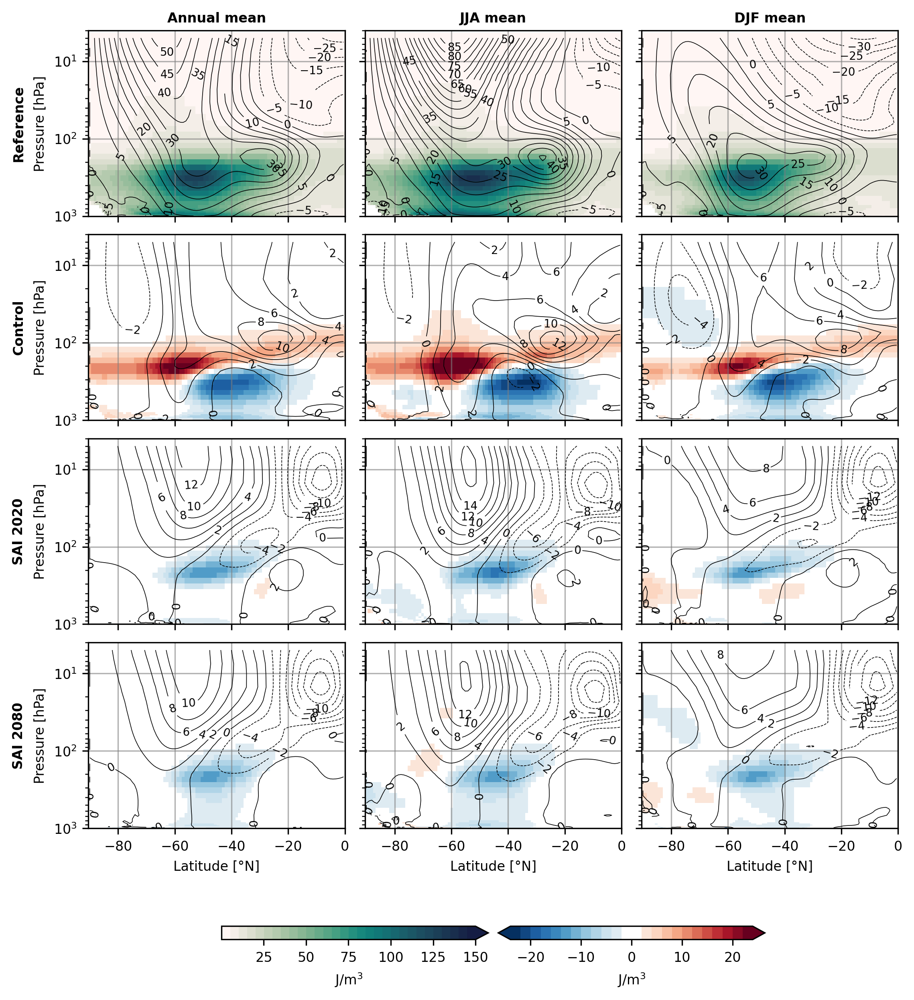

In [20]:
scen = ['i_c', 'cref', '20ref', '80ref']
scenJJA = ['iJJA_c', 'crefJJA', '20refJJA', '80refJJA']
scenDJF = ['iDJF_c', 'crefDJF', '20refDJF', '80refDJF']
scen_stack = np.asarray([scen, scenJJA, scenDJF])

scens_used = scen_stack.T.flatten()

sidelabels = ['Reference', 'Control', 'SAI 2020', 'SAI 2080']
toplabels = ['Annual mean', 'JJA mean', 'DJF mean']

yoink = mpl.colormaps['RdBu_r'].resampled(24)
newcolors = yoink(np.linspace(0,1,24))
white = np.array([1, 1, 1, 1])
newcolors[11:13,:] = white
comap = colors.ListedColormap(newcolors)

fig, axs = plt.subplots(4, 3, figsize=imgsize2, layout='constrained')
ax = axs.flatten()

font_kwargs = dict(fontweight="bold", fontsize=8)
add_headers(fig, col_headers=toplabels, row_headers=sidelabels, **font_kwargs)

for i,j in zip(ax,scens_used):    
    if j in scen_stack[:,0]:
        im = EKEzm[j].plot(ax=i, x='lat', y='plev', cmap=plt.get_cmap('cmo.tempo',30), vmax=150, add_colorbar=False)
    
        plot = Uzm[j].plot.contour(ax=i, x='lat', y='plev', colors='k', linewidths=0.4, vmin=-100, vmax=100, levels=41, kwargs=dict(inline=True))
        i.clabel(plot, fontsize='small', inline_spacing=1)
    
        i.set_xlabel(None)
        i.set_ylabel(None)
        i.invert_yaxis()
        i.set_yscale('log')
        i.grid(color='gray', alpha=0.6)
        i.set_ylim(10**3,4)
            
    else:
        im2 = EKEzm[j].plot(ax=i, x='lat', y='plev', cmap=comap, vmin=-24, vmax=24, add_colorbar=False)

        plot = Uzm[j].plot.contour(ax=i, x='lat', y='plev', colors='k', linewidths=0.4, vmin=-16, vmax=16, levels=17, kwargs=dict(inline=True))
        i.clabel(plot, fontsize='small', inline_spacing=1)
    
        i.set_xlabel(None)
        i.set_ylabel(None)
        i.invert_yaxis()
        i.set_yscale('log')
        i.grid(color='gray', alpha=0.6)
        i.set_ylim(10**3,4)

    if i in axs[:,1:].flatten():
        i.set_yticklabels([])
    
    if i in axs[:,0].flatten():
        i.set_ylabel('Pressure [hPa]')
    
    if i in axs[:-1,:].flatten():
        i.set_xticklabels([])
    
    if i in axs[-1,:].flatten():
        i.set_xlabel('Latitude [°N]')


plt.colorbar(im, ax=axs[:,:2], shrink=0.5, location='bottom', label=r'J/m$^3$', extend='max')
plt.colorbar(im2, ax=axs[:,1:], shrink=0.5, location='bottom', label=r'J/m$^3$', extend='both')


if save == True: plt.savefig(savepath+'EKE_U_zmdiff_full.png');


## Annual mean plots

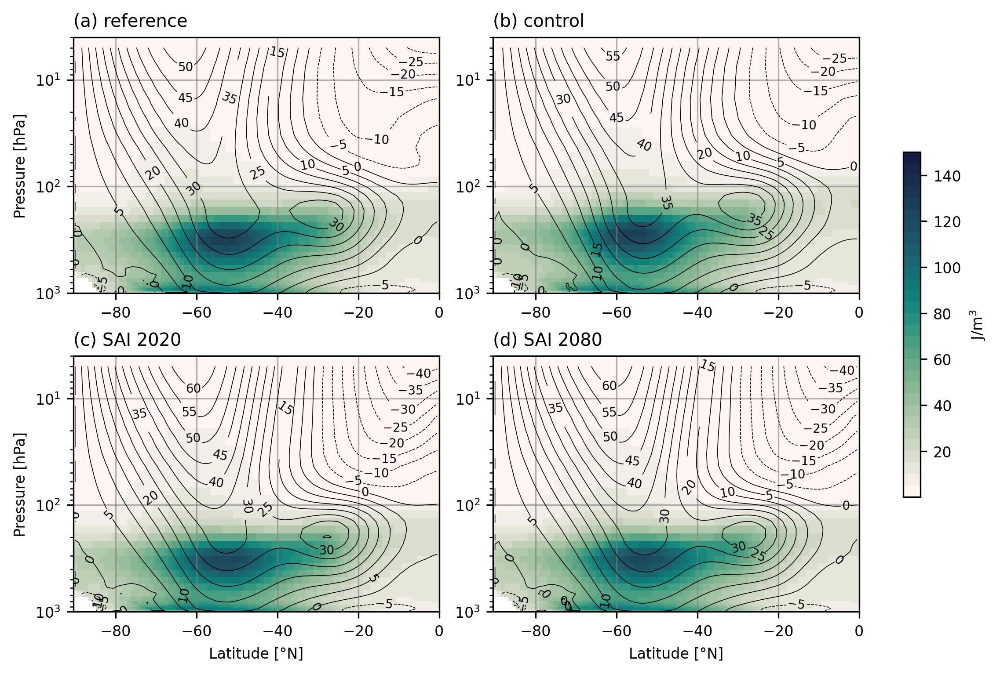

In [21]:
scen_used = ['i_c', 'f_c', 'f_20', 'f_80']
labels = ['(a) reference', '(b) control', '(c) SAI 2020', '(d) SAI 2080']
timesel = 'ann'

EKEplot()

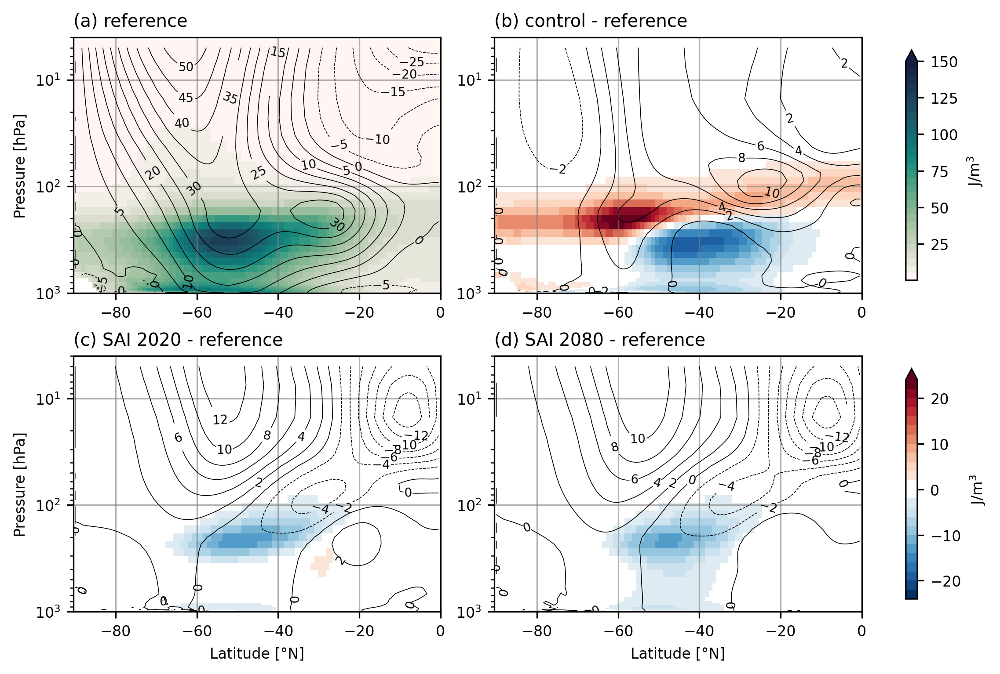

In [22]:
scen_used = ['i_c', 'cref', '20ref', '80ref']
labels = ['(a) reference', '(b) control - reference', '(c) SAI 2020 - reference', '(d) SAI 2080 - reference']
timesel = 'ann'

EKEdiffplot()

## Seasonal mean plots - JJA

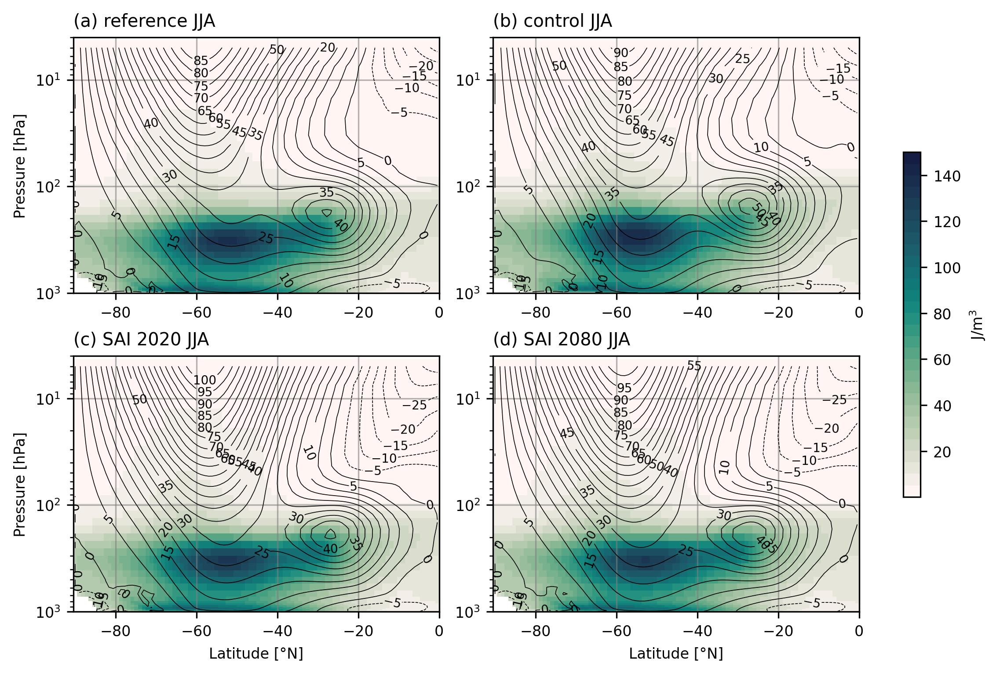

In [23]:
scen_used = ['iJJA_c', 'fJJA_c', 'fJJA_20', 'fJJA_80']
labels = ['(a) reference JJA', '(b) control JJA', '(c) SAI 2020 JJA', '(d) SAI 2080 JJA']
timesel = 'JJA'

EKEplot()

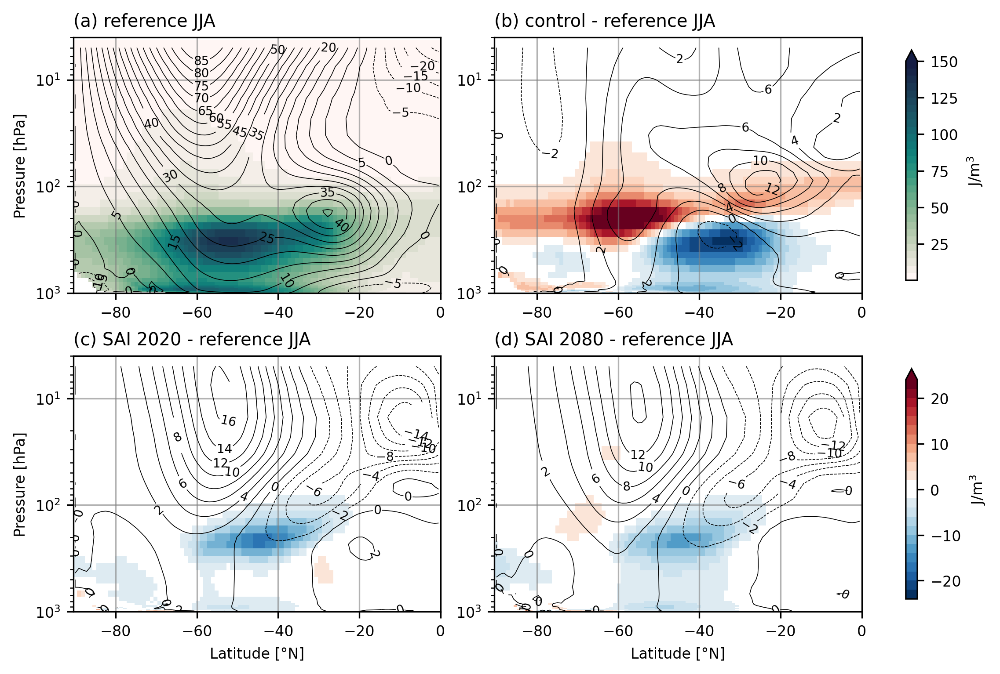

In [24]:
scen_used = ['iJJA_c', 'crefJJA', '20refJJA', '80refJJA']
labels = ['(a) reference JJA', '(b) control - reference JJA', '(c) SAI 2020 - reference JJA', '(d) SAI 2080 - reference JJA']
timesel = 'JJA'

EKEdiffplot()

## Seasonal mean plots - DJF

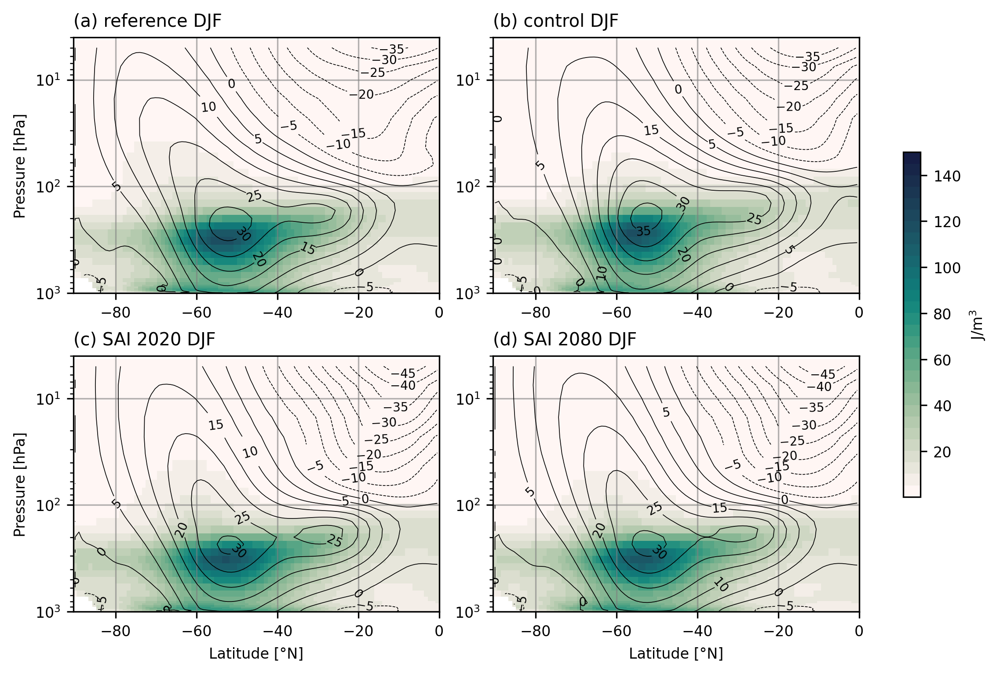

In [25]:
scen_used = ['iDJF_c', 'fDJF_c', 'fDJF_20', 'fDJF_80']
labels = ['(a) reference DJF', '(b) control DJF', '(c) SAI 2020 DJF', '(d) SAI 2080 DJF']
timesel = 'DJF'

EKEplot()

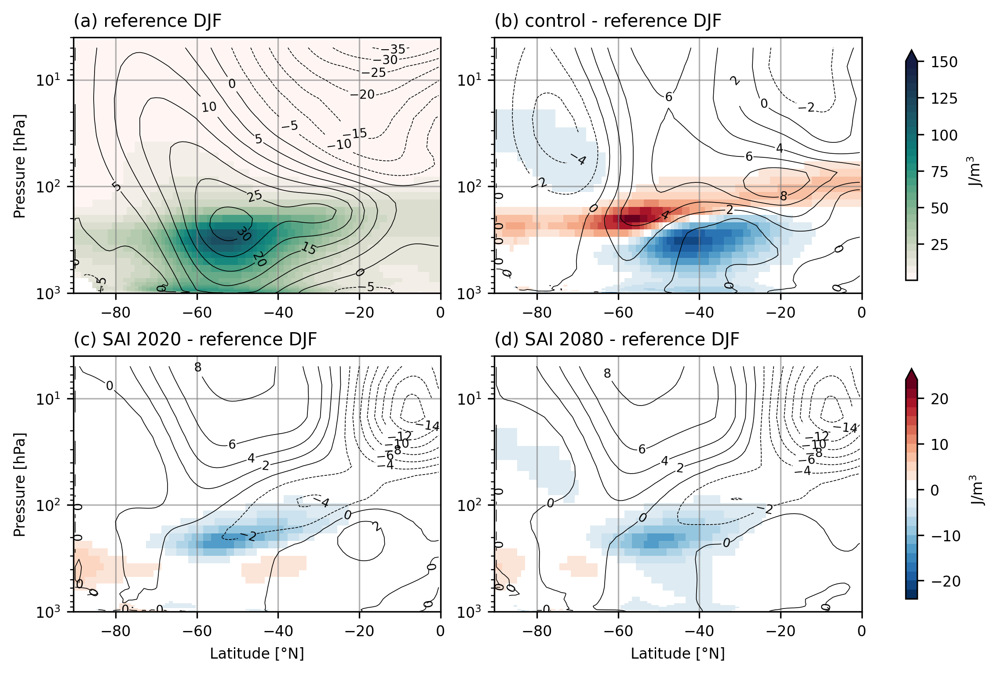

In [26]:
scen_used = ['iDJF_c', 'crefDJF', '20refDJF', '80refDJF']
labels = ['(a) reference DJF', '(b) control - reference DJF', '(c) SAI 2020 - reference DJF', '(d) SAI 2080 - reference DJF']
timesel = 'DJF'

EKEdiffplot()

# 60° lon slices

### Data

In [27]:
# EKE_slices = {}
# U_slices = {}
# scens_slices = np.full((len(scens),6), 'fillers')
# for i,j in zip(scens,range(len(scens))):
#     scens_slices[j,0] = ('60'+i)
#     scens_slices[j,1] = ('120'+i)
#     scens_slices[j,2] = ('180'+i)
#     scens_slices[j,3] = ('240'+i)
#     scens_slices[j,4] = ('300'+i)
#     scens_slices[j,5] = ('360'+i)

#     EKE_slices['60'+i] = time_mean(EKE(U[i],V[i],UU[i],VV[i],T[i]))['EKE'].sel(lon=slice(0,60)).mean(dim='lon')
#     EKE_slices['120'+i] = time_mean(EKE(U[i],V[i],UU[i],VV[i],T[i]))['EKE'].sel(lon=slice(60,120)).mean(dim='lon')
#     EKE_slices['180'+i] = time_mean(EKE(U[i],V[i],UU[i],VV[i],T[i]))['EKE'].sel(lon=slice(120,180)).mean(dim='lon')
#     EKE_slices['240'+i] = time_mean(EKE(U[i],V[i],UU[i],VV[i],T[i]))['EKE'].sel(lon=slice(180,240)).mean(dim='lon')
#     EKE_slices['300'+i] = time_mean(EKE(U[i],V[i],UU[i],VV[i],T[i]))['EKE'].sel(lon=slice(240,300)).mean(dim='lon')
#     EKE_slices['360'+i] = time_mean(EKE(U[i],V[i],UU[i],VV[i],T[i]))['EKE'].sel(lon=slice(300,360)).mean(dim='lon')

#     U_slices['60'+i] = time_mean(U[i])['U'].sel(lon=slice(0,60)).mean(dim='lon')
#     U_slices['120'+i] = time_mean(U[i])['U'].sel(lon=slice(60,120)).mean(dim='lon')
#     U_slices['180'+i] = time_mean(U[i])['U'].sel(lon=slice(120,180)).mean(dim='lon')
#     U_slices['240'+i] = time_mean(U[i])['U'].sel(lon=slice(180,240)).mean(dim='lon')
#     U_slices['300'+i] = time_mean(U[i])['U'].sel(lon=slice(240,300)).mean(dim='lon')
#     U_slices['360'+i] = time_mean(U[i])['U'].sel(lon=slice(300,360)).mean(dim='lon')


# scensJJA_slices = np.full((len(scensJJA),6), 'fillersJJA')

# for i,j in zip(scensJJA,range(len(scensJJA))):
#     scensJJA_slices[j,0] = ('60'+i)
#     scensJJA_slices[j,1] = ('120'+i)
#     scensJJA_slices[j,2] = ('180'+i)
#     scensJJA_slices[j,3] = ('240'+i)
#     scensJJA_slices[j,4] = ('300'+i)
#     scensJJA_slices[j,5] = ('360'+i)

#     EKE_slices['60'+i] = time_mean(EKE(U[i],V[i],UU[i],VV[i],T[i]))['EKE'].sel(lon=slice(0,60)).mean(dim='lon')
#     EKE_slices['120'+i] = time_mean(EKE(U[i],V[i],UU[i],VV[i],T[i]))['EKE'].sel(lon=slice(60,120)).mean(dim='lon')
#     EKE_slices['180'+i] = time_mean(EKE(U[i],V[i],UU[i],VV[i],T[i]))['EKE'].sel(lon=slice(120,180)).mean(dim='lon')
#     EKE_slices['240'+i] = time_mean(EKE(U[i],V[i],UU[i],VV[i],T[i]))['EKE'].sel(lon=slice(180,240)).mean(dim='lon')
#     EKE_slices['300'+i] = time_mean(EKE(U[i],V[i],UU[i],VV[i],T[i]))['EKE'].sel(lon=slice(240,300)).mean(dim='lon')
#     EKE_slices['360'+i] = time_mean(EKE(U[i],V[i],UU[i],VV[i],T[i]))['EKE'].sel(lon=slice(300,360)).mean(dim='lon')

#     U_slices['60'+i] = time_mean(U[i])['U'].sel(lon=slice(0,60)).mean(dim='lon')
#     U_slices['120'+i] = time_mean(U[i])['U'].sel(lon=slice(60,120)).mean(dim='lon')
#     U_slices['180'+i] = time_mean(U[i])['U'].sel(lon=slice(120,180)).mean(dim='lon')
#     U_slices['240'+i] = time_mean(U[i])['U'].sel(lon=slice(180,240)).mean(dim='lon')
#     U_slices['300'+i] = time_mean(U[i])['U'].sel(lon=slice(240,300)).mean(dim='lon')
#     U_slices['360'+i] = time_mean(U[i])['U'].sel(lon=slice(300,360)).mean(dim='lon')

## Plots

### Annual

In [28]:
# scens_used = scens_slices.T.flatten()
# toplabels = ['(a) reference', '(b) control', '(c) SAI 2020', '(d) SAI 2080']
# sidelabels = ['0° - 60°', '60° - 120°', '120° - 180°', '180° - 240°', '240° - 300°', '300° - 360°']

# fig, axs = plt.subplots(6, 4, figsize=imgsize2, layout='constrained')
# ax = axs.flatten()

# font_kwargs = dict(fontweight="bold", fontsize=8)
# add_headers(fig, col_headers=toplabels, row_headers=sidelabels, **font_kwargs)

# for i,j in zip(ax,scens_used):    
#     im = EKE_slices[j].plot(ax=i, x='lat', y='plev', cmap=plt.get_cmap('cmo.dense',30), vmax=150, add_colorbar=False)

#     plot = U_slices[j].plot.contour(ax=i, x='lat', y='plev', colors='k', linewidths=0.4, vmin=-60, vmax=60, levels=25, kwargs=dict(inline=True))
#     i.clabel(plot, fontsize='small', inline_spacing=1)

#     i.set_xlabel(None)
#     i.set_ylabel(None)
#     i.invert_yaxis()
#     i.set_yscale('log')
#     i.grid(color='gray', alpha=0.6)
#     i.set_ylim(10**3,4)

#     if i in axs[:,1:].flatten():
#         i.set_yticklabels([])
    
#     if i in axs[:,0].flatten():
#         i.set_ylabel('Pressure [hPa]')
    
#     if i in axs[:-1,:].flatten():
#         i.set_xticklabels([])
    
#     if i in axs[-1,:].flatten():
#         i.set_xlabel('Latitude [°N]')


# plt.colorbar(im, ax=axs, shrink=0.5, location='bottom', label=r'm$^2$s$^{-2}$', extend='max')

# if save == True: plt.savefig(savepath+'EKE_U_slices_ann.png'); 


### JJA

In [29]:
# scens_used = scensJJA_slices.T.flatten()
# toplabels = ['(a) reference JJA', '(b) control JJA', '(c) SAI 2020 JJA', '(d) SAI 2080 JJA']
# sidelabels = ['0° - 60°', '60° - 120°', '120° - 180°', '180° - 240°', '240° - 300°', '300° - 360°']

# fig, axs = plt.subplots(6, 4, figsize=imgsize2, layout='constrained')
# ax = axs.flatten()

# font_kwargs = dict(fontweight="bold", fontsize=8)
# add_headers(fig, col_headers=toplabels, row_headers=sidelabels, **font_kwargs)

# for i,j in zip(ax,scens_used):
#     im = EKE_slices[j].plot(ax=i, x='lat', y='plev', cmap=plt.get_cmap('cmo.dense',30), vmax=150, add_colorbar=False)

#     plot = U_slices[j].plot.contour(ax=i, x='lat', y='plev', colors='k', linewidths=0.4, vmin=-100, vmax=100, levels=41, kwargs=dict(inline=True))
#     i.clabel(plot, fontsize='small', inline_spacing=1)

#     i.set_xlabel(None)
#     i.set_ylabel(None)
#     i.invert_yaxis()
#     i.set_yscale('log')
#     i.grid(color='gray', alpha=0.6)
#     i.set_ylim(10**3,4)

#     if i in axs[:,1:].flatten():
#         i.set_yticklabels([])
    
#     if i in axs[:,0].flatten():
#         i.set_ylabel('Pressure [hPa]')
    
#     if i in axs[:-1,:].flatten():
#         i.set_xticklabels([])
    
#     if i in axs[-1,:].flatten():
#         i.set_xlabel('Latitude [°N]')


# plt.colorbar(im, ax=axs, shrink=0.5, location='bottom', label=r'm$^2$s$^{-2}$', extend='max')

# if save == True: plt.savefig(savepath+'EKE_U_slices_JJA.png');


# Kinetic energy

In [30]:
### calculate zonal mean kinetic energy 
KEzm = {}

for i in scens:
    KEzm[i] = time_mean(KE(UU[i],VV[i],T[i]))['KE'].mean(dim='lon')

for i in scensJJA:
    KEzm[i] = time_mean(KE(UU[i],VV[i],T[i]))['KE'].mean(dim='lon')

for i in scensDJF:
    KEzm[i] = time_mean(KE(UU[i],VV[i],T[i]))['KE'].mean(dim='lon')
    

In [31]:
%%time
for i in scens:
    KEzm[i].compute()

for i in scensJJA:
    KEzm[i].compute()

for i in scensDJF:
    KEzm[i].compute()

print('Computed')

Computed
CPU times: user 23 s, sys: 22.2 s, total: 45.2 s
Wall time: 1min 6s


In [32]:
%%time
for i,j in zip(diffscens,scens[1:]):
    KEzm[i] = (KEzm[j] - KEzm['i_c']).compute()

for i,j in zip(diffscensJJA,scensJJA[1:]):
    KEzm[i] = (KEzm[j] - KEzm['iJJA_c']).compute()

for i,j in zip(diffscensDJF,scensDJF[1:]):
    KEzm[i] = (KEzm[j] - KEzm['iDJF_c']).compute()

print('Computed')

Computed
CPU times: user 34.8 s, sys: 33.1 s, total: 1min 7s
Wall time: 1min 41s


## Plotfuncs

In [33]:
def KEplot():
    fig, axs = plt.subplots(2, 2, figsize=imgsize1, layout='constrained')

    for i,j,k in zip(axs.flatten(),scen_used,labels):
        im = KEzm[j].plot(ax=i, x='lat', y='plev', cmap=plt.get_cmap('cmo.dense',35), vmax=900, add_colorbar=False)
    
        plot = Uzm[j].plot.contour(ax=i, x='lat', y='plev', colors='k', linewidths=0.4, vmin=-100, vmax=100, levels=41, kwargs=dict(inline=True))
        i.clabel(plot, fontsize='small', inline_spacing=1)
    
        i.set_xlabel(None)
        i.set_ylabel(None)
        i.invert_yaxis()
        i.set_yscale('log')
        i.grid(color='gray', alpha=0.6)
        i.set_ylim(10**3,4)
    
        i.set_title(k, loc='left')
    
    axs[1,0].set_xlabel('Latitude [°N]')
    axs[1,1].set_xlabel('Latitude [°N]')
    axs[0,0].set_ylabel('Pressure [hPa]')
    axs[1,0].set_ylabel('Pressure [hPa]')
    
    
    plt.colorbar(im, ax=axs, shrink=0.6, location='right', label=r'J/m$^3$', extend='max')
    
    if save == True: plt.savefig(savepath+'KE_U_zm_'+timesel+'.png');
        

In [34]:
def KEdiffplot():
    # comap = plt.get_cmap('RdBu_r')
    # bounds = np.concatenate([np.arange(-130,-1,10), np.arange(10,131,10)])
    # norm = colors.BoundaryNorm(bounds, comap.N)

    yoink = mpl.colormaps['RdBu_r'].resampled(26)
    newcolors = yoink(np.linspace(0,1,26))
    white = np.array([1, 1, 1, 1])
    newcolors[12:14,:] = white
    comap = colors.ListedColormap(newcolors)

    fig, axs = plt.subplots(2, 2, figsize=imgsize1, layout='constrained')

    for i,j,k in zip(axs.flatten(),scen_used,labels):
        if j == scen_used[0]:
            im = KEzm[j].plot(ax=i, x='lat', y='plev', cmap=plt.get_cmap('cmo.dense',35), vmax=900, add_colorbar=False)
        
            plot = Uzm[j].plot.contour(ax=i, x='lat', y='plev', colors='k', linewidths=0.4, vmin=-100, vmax=100, levels=41, kwargs=dict(inline=True))
            i.clabel(plot, fontsize='small', inline_spacing=1)
        
            i.set_xlabel(None)
            i.set_ylabel(None)
            i.invert_yaxis()
            i.set_yscale('log')
            i.grid(color='gray', alpha=0.6)
            i.set_ylim(10**3,4)
        
            i.set_title(k, loc='left')
        else:
            im2 = KEzm[j].plot(ax=i, x='lat', y='plev', cmap=comap, add_colorbar=False)
        
            plot = Uzm[j].plot.contour(ax=i, x='lat', y='plev', colors='k', linewidths=0.4, vmin=-16, vmax=16, levels=17, kwargs=dict(inline=True))
            i.clabel(plot, fontsize='small', inline_spacing=1)
        
            i.set_xlabel(None)
            i.set_ylabel(None)
            i.invert_yaxis()
            i.set_yscale('log')
            i.grid(color='gray', alpha=0.6)
            i.set_ylim(10**3,4)
        
            i.set_title(k, loc='left')
    
    axs[1,0].set_xlabel('Latitude [°N]')
    axs[1,1].set_xlabel('Latitude [°N]')
    axs[0,0].set_ylabel('Pressure [hPa]')
    axs[1,0].set_ylabel('Pressure [hPa]')
    
    
    plt.colorbar(im, ax=axs[0,:], shrink=0.9, location='right', label=r'J/m$^3$', extend='max')
    plt.colorbar(im2, ax=axs[1,:], shrink=0.9, location='right', label=r'J/m$^3$', extend='max', ticks=[-120,-80,-40,0,40,80,120],spacing='proportional').minorticks_off()
    
    if save == True: plt.savefig(savepath+'KE_U_zmdiff_'+timesel+'.png');
        

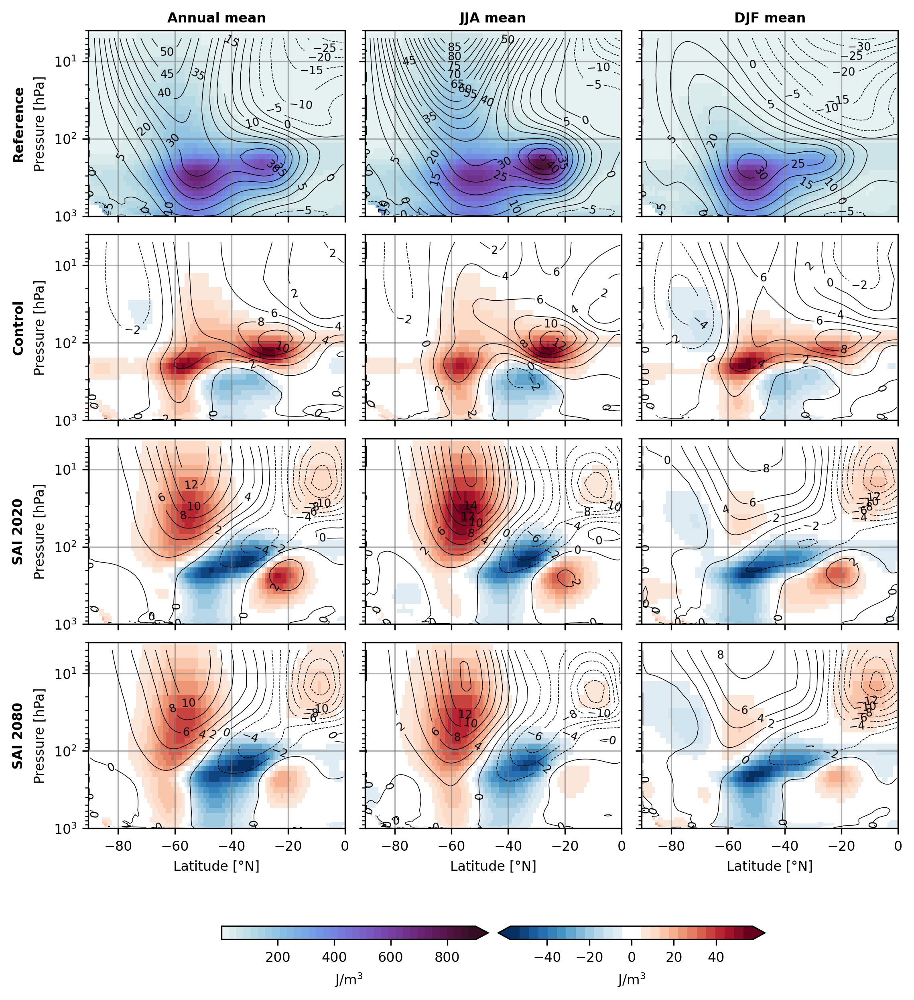

In [35]:
scen = ['i_c', 'cref', '20ref', '80ref']
scenJJA = ['iJJA_c', 'crefJJA', '20refJJA', '80refJJA']
scenDJF = ['iDJF_c', 'crefDJF', '20refDJF', '80refDJF']
scen_stack = np.asarray([scen, scenJJA, scenDJF])

scens_used = scen_stack.T.flatten()

sidelabels = ['Reference', 'Control', 'SAI 2020', 'SAI 2080']
toplabels = ['Annual mean', 'JJA mean', 'DJF mean']

yoink = mpl.colormaps['RdBu_r'].resampled(26)
newcolors = yoink(np.linspace(0,1,26))
white = np.array([1, 1, 1, 1])
newcolors[12:14,:] = white
comap = colors.ListedColormap(newcolors)

fig, axs = plt.subplots(4, 3, figsize=imgsize2, layout='constrained')
ax = axs.flatten()

font_kwargs = dict(fontweight="bold", fontsize=8)
add_headers(fig, col_headers=toplabels, row_headers=sidelabels, **font_kwargs)

for i,j in zip(ax,scens_used):    
    if j in scen_stack[:,0]:
        im = KEzm[j].plot(ax=i, x='lat', y='plev', cmap=plt.get_cmap('cmo.dense',35), vmax=900, add_colorbar=False)
    
        plot = Uzm[j].plot.contour(ax=i, x='lat', y='plev', colors='k', linewidths=0.4, vmin=-100, vmax=100, levels=41, kwargs=dict(inline=True))
        i.clabel(plot, fontsize='small', inline_spacing=1)
    
        i.set_xlabel(None)
        i.set_ylabel(None)
        i.invert_yaxis()
        i.set_yscale('log')
        i.grid(color='gray', alpha=0.6)
        i.set_ylim(10**3,4)
            
    else:
        im2 = KEzm[j].plot(ax=i, x='lat', y='plev', cmap=comap, add_colorbar=False)
    
        plot = Uzm[j].plot.contour(ax=i, x='lat', y='plev', colors='k', linewidths=0.4, vmin=-16, vmax=16, levels=17, kwargs=dict(inline=True))
        i.clabel(plot, fontsize='small', inline_spacing=1)
    
        i.set_xlabel(None)
        i.set_ylabel(None)
        i.invert_yaxis()
        i.set_yscale('log')
        i.grid(color='gray', alpha=0.6)
        i.set_ylim(10**3,4)

    if i in axs[:,1:].flatten():
        i.set_yticklabels([])
    
    if i in axs[:,0].flatten():
        i.set_ylabel('Pressure [hPa]')
    
    if i in axs[:-1,:].flatten():
        i.set_xticklabels([])
    
    if i in axs[-1,:].flatten():
        i.set_xlabel('Latitude [°N]')


plt.colorbar(im, ax=axs[:,:2], shrink=0.5, location='bottom', label=r'J/m$^3$', extend='max')
plt.colorbar(im2, ax=axs[:,1:], shrink=0.5, location='bottom', label=r'J/m$^3$', extend='both')


if save == True: plt.savefig(savepath+'KE_U_zmdiff_full.png');


## Annual mean plots

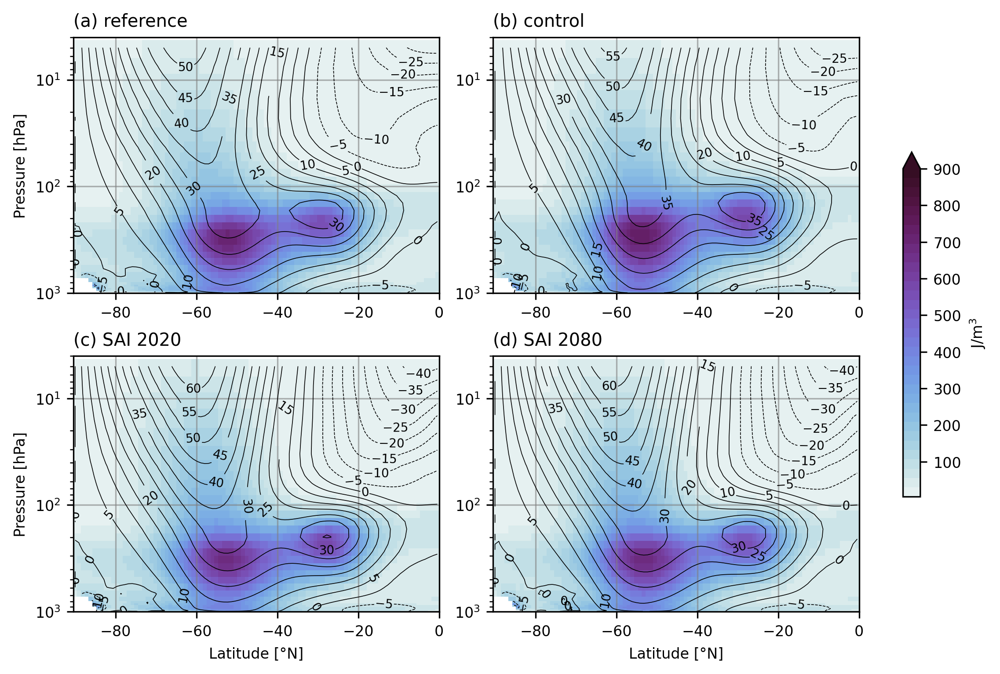

In [36]:
scen_used = ['i_c', 'f_c', 'f_20', 'f_80']
labels = ['(a) reference', '(b) control', '(c) SAI 2020', '(d) SAI 2080']
timesel = 'ann'

KEplot()

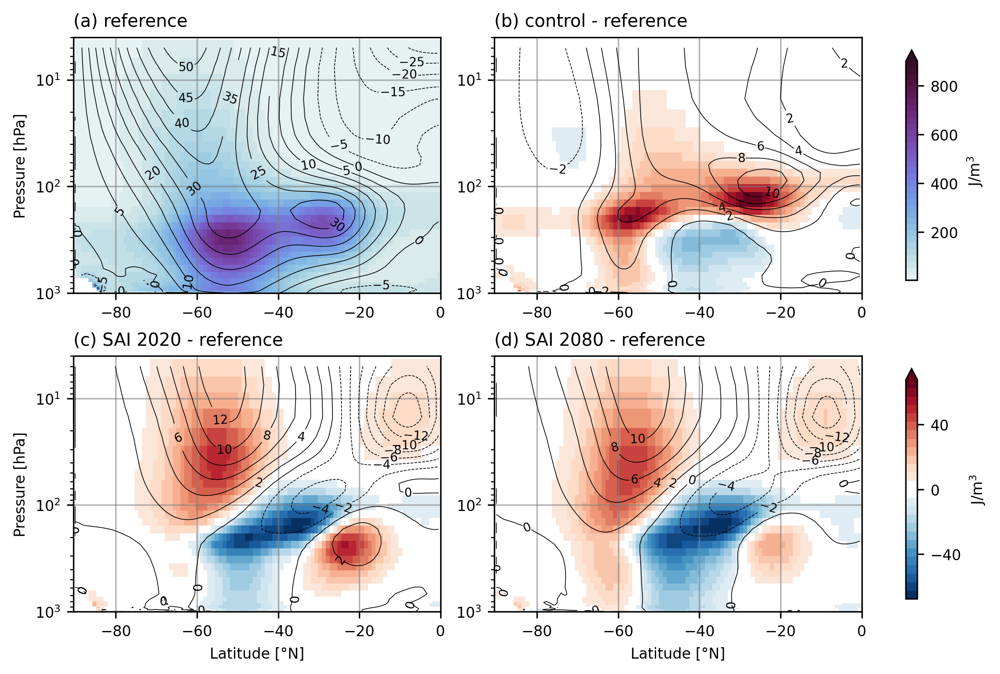

In [37]:
scen_used = ['i_c', 'cref', '20ref', '80ref']
labels = ['(a) reference', '(b) control - reference', '(c) SAI 2020 - reference', '(d) SAI 2080 - reference']
timesel = 'ann'

KEdiffplot()

## JJA mean plots

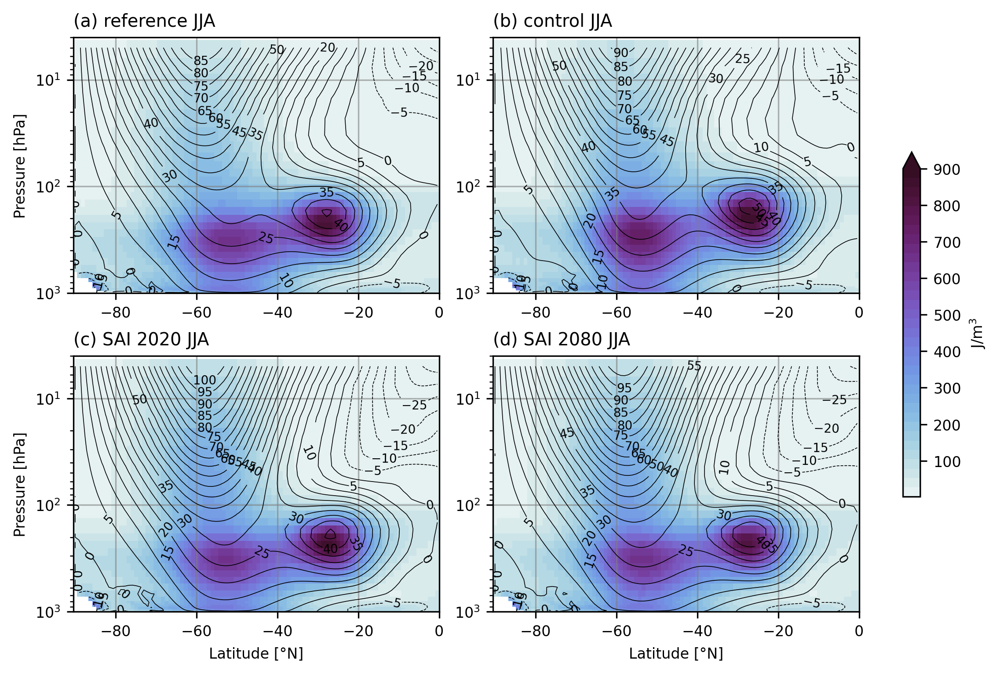

In [38]:
scen_used = ['iJJA_c', 'fJJA_c', 'fJJA_20', 'fJJA_80']
labels = ['(a) reference JJA', '(b) control JJA', '(c) SAI 2020 JJA', '(d) SAI 2080 JJA']
timesel = 'JJA'

KEplot()

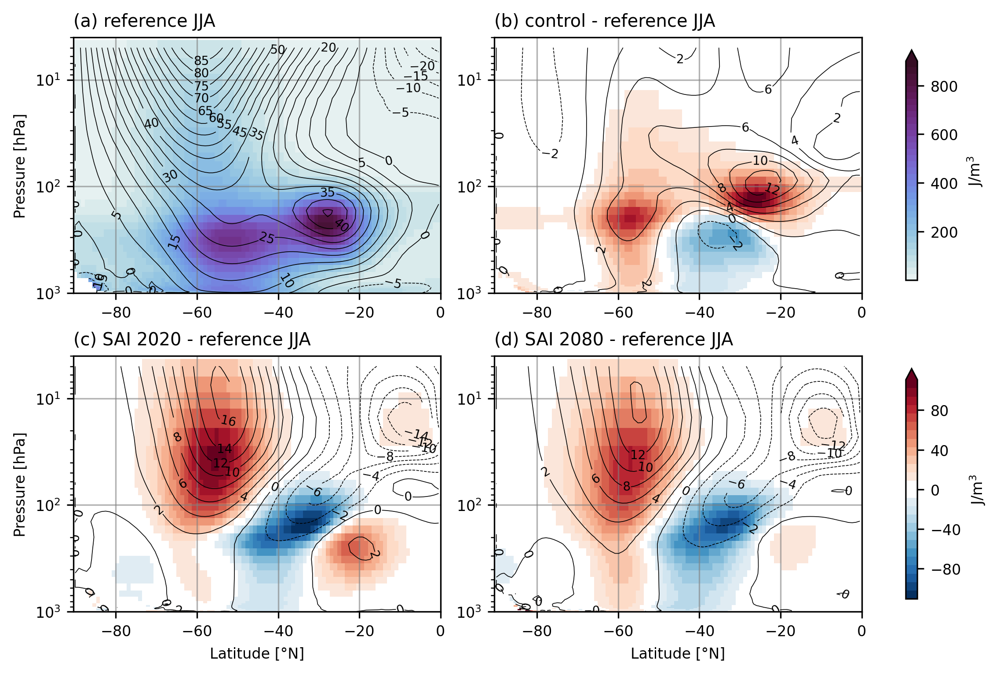

In [39]:
scen_used = ['iJJA_c', 'crefJJA', '20refJJA', '80refJJA']
labels = ['(a) reference JJA', '(b) control - reference JJA', '(c) SAI 2020 - reference JJA', '(d) SAI 2080 - reference JJA']
timesel = 'JJA'

KEdiffplot()

## DJF mean plots

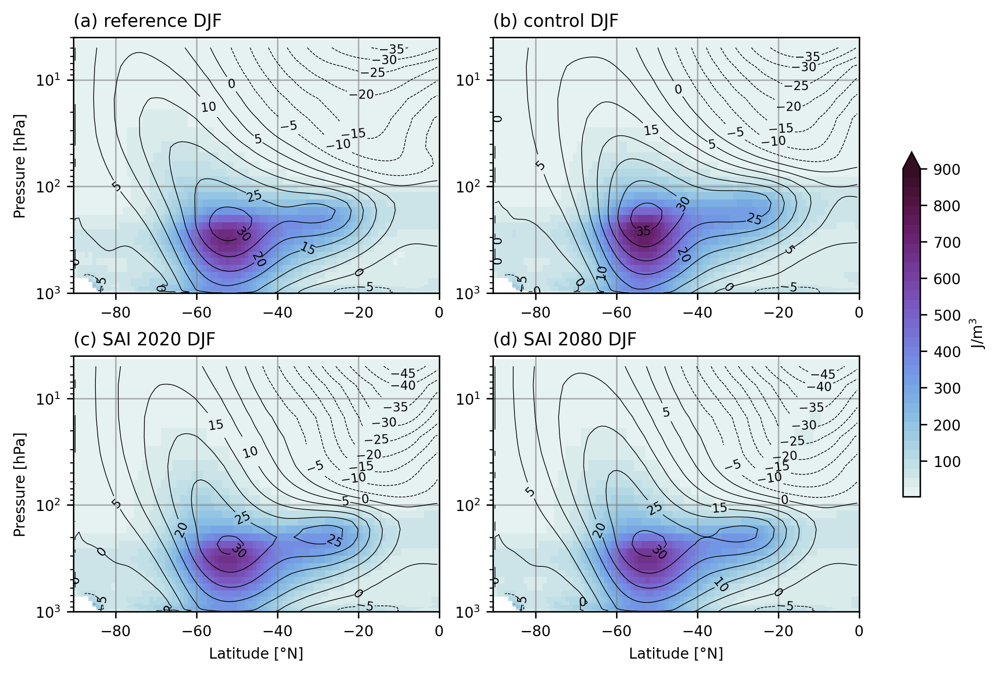

In [40]:
scen_used = ['iDJF_c', 'fDJF_c', 'fDJF_20', 'fDJF_80']
labels = ['(a) reference DJF', '(b) control DJF', '(c) SAI 2020 DJF', '(d) SAI 2080 DJF']
timesel = 'DJF'

KEplot()

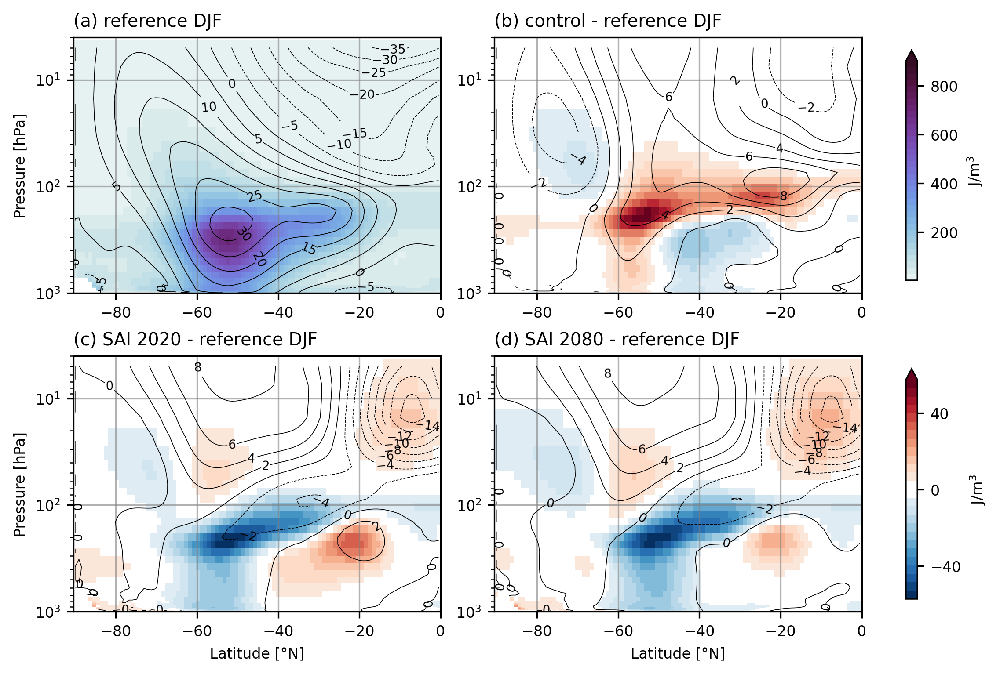

In [41]:
scen_used = ['iDJF_c', 'crefDJF', '20refDJF', '80refDJF']
labels = ['(a) reference DJF', '(b) control - reference DJF', '(c) SAI 2020 - reference DJF', '(d) SAI 2080 - reference DJF']
timesel = 'DJF'

KEdiffplot()

# Jet position

## Eddy-driven jet

In [16]:
latmin = -85
latmax = -15
plevmin = 150
plevmax = 600
thresh = 105

EDJ = {}
for i in scens:
    EDJ[i] = jet_loc(EKE(U[i], V[i], UU[i], VV[i], T[i]), 'EKE', thresh, lats=slice(latmin,latmax), plevs=slice(plevmin,plevmax))['count']

for i in scensJJA:
    EDJ[i] = jet_loc(EKE(U[i], V[i], UU[i], VV[i], T[i]), 'EKE', thresh, lats=slice(latmin,latmax), plevs=slice(plevmin,plevmax))['count']

for i in scensDJF:
    EDJ[i] = jet_loc(EKE(U[i], V[i], UU[i], VV[i], T[i]), 'EKE', thresh, lats=slice(latmin,latmax), plevs=slice(plevmin,plevmax))['count']


In [17]:
EDJpm = {}
for i in scens:
    EDJpm[i] = (EDJ[i].sum(dim=['time','plev'])/(len(EDJ[i].time)*len(EDJ[i].plev))).compute()

for i in scensJJA:
    EDJpm[i] = (EDJ[i].sum(dim=['time','plev'])/(len(EDJ[i].time)*len(EDJ[i].plev))).compute()

for i in scensDJF:
    EDJpm[i] = (EDJ[i].sum(dim=['time','plev'])/(len(EDJ[i].time)*len(EDJ[i].plev))).compute()


In [18]:
EDJmax = {}
for i in scens:
    EDJmax[i] = jet_max(EKE(U[i], V[i], UU[i], VV[i], T[i]), 'EKE', lats=slice(latmin,latmax), plevs=slice(plevmin,plevmax)).mean(dim='time')

for i in scensJJA:
    EDJmax[i] = jet_max(EKE(U[i], V[i], UU[i], VV[i], T[i]), 'EKE', lats=slice(latmin,latmax), plevs=slice(plevmin,plevmax)).mean(dim='time')

for i in scensDJF:
    EDJmax[i] = jet_max(EKE(U[i], V[i], UU[i], VV[i], T[i]), 'EKE', lats=slice(latmin,latmax), plevs=slice(plevmin,plevmax)).mean(dim='time')


## Intensity plots

In [45]:
def EDJplot():
    fig, axs = plt.subplots(2, 2, figsize=imgsize1, layout='constrained', dpi=imgres, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=0, globe=None)})
    
    for i,j,k in zip(axs.flatten(),scen_used,labels):
        i.coastlines(resolution='50m', linewidth=0.5)
        
        im = EDJpm[j].plot(ax=i, transform=ccrs.PlateCarree(), cmap=plt.get_cmap('magma_r',30), vmin=0.05, vmax=0.8, add_colorbar=False)
        im.cmap.set_under('w')
    
        gl = i.gridlines(crs=ccrs.PlateCarree(), draw_labels=False, linewidth=0.5, color='dimgray', alpha=0.6, linestyle='-')
    
        i.set_title(k, loc='left')
    
    plt.colorbar(im, ax=axs, shrink=0.6, location='right', label=r'Intensity', extend='neither', ticks=[0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1.0])
    
    if save == True: plt.savefig(savepath+'EDJ_map_'+timesel+'.png');


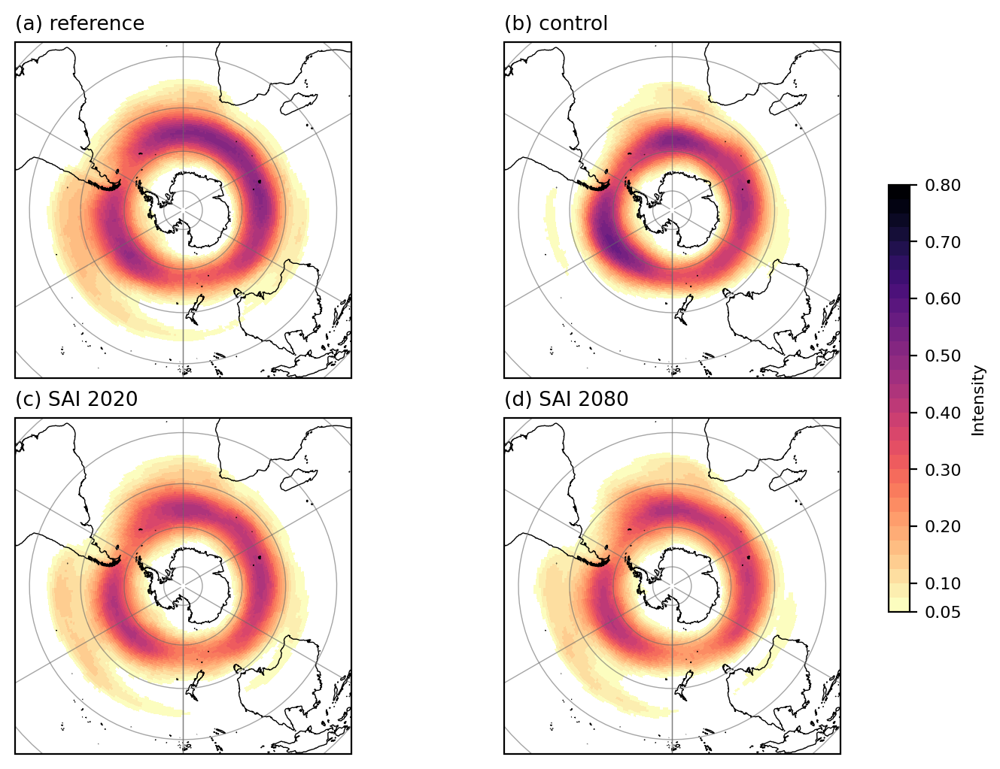

In [46]:
scen_used = ['i_c', 'f_c', 'f_20', 'f_80']
labels = ['(a) reference', '(b) control', '(c) SAI 2020', '(d) SAI 2080']
timesel = 'ann'

EDJplot()

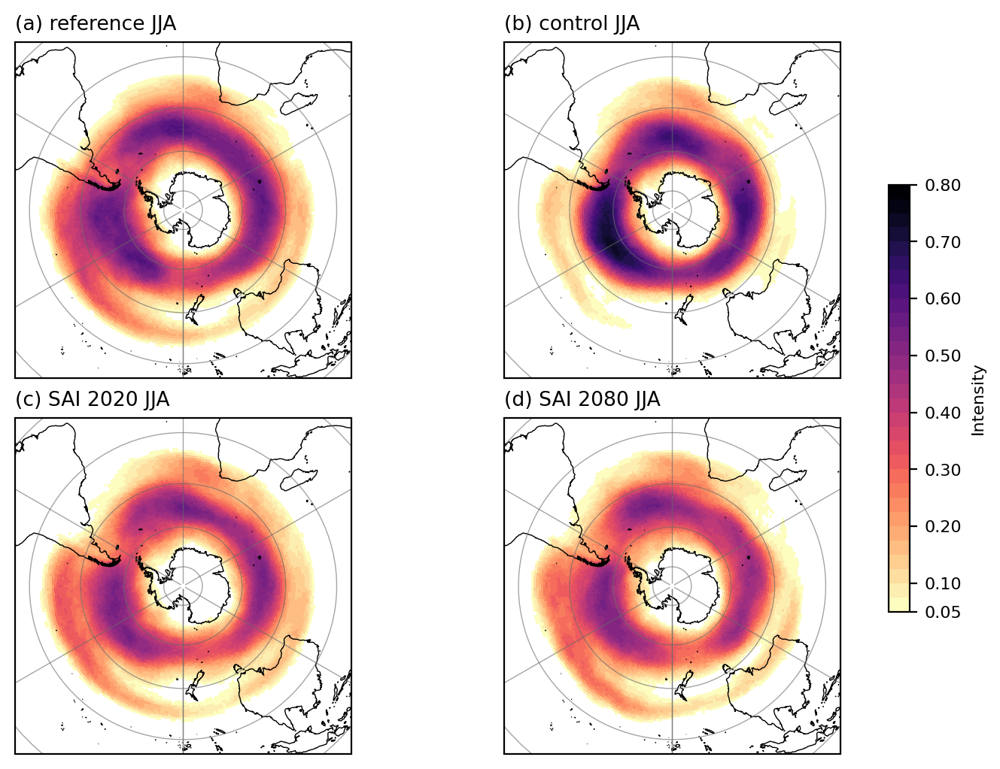

In [47]:
scen_used = ['iJJA_c', 'fJJA_c', 'fJJA_20', 'fJJA_80']
labels = ['(a) reference JJA', '(b) control JJA', '(c) SAI 2020 JJA', '(d) SAI 2080 JJA']
timesel = 'JJA'

EDJplot()

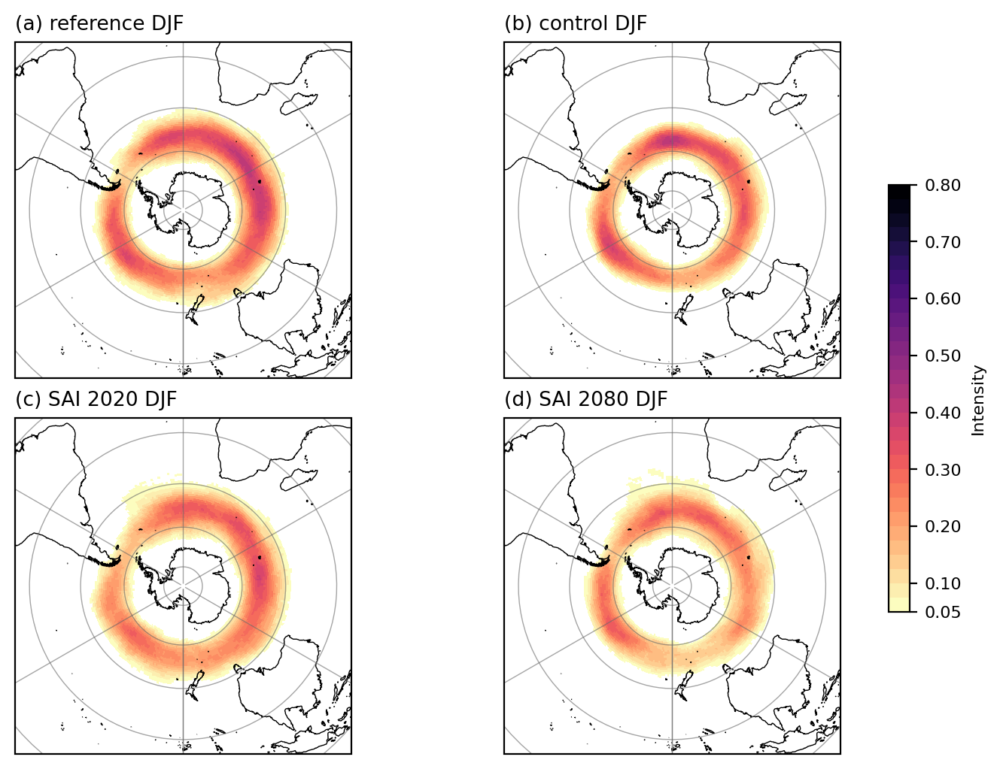

In [48]:
scen_used = ['iDJF_c', 'fDJF_c', 'fDJF_20', 'fDJF_80']
labels = ['(a) reference DJF', '(b) control DJF', '(c) SAI 2020 DJF', '(d) SAI 2080 DJF']
timesel = 'DJF'

EDJplot()

## Maxloc plots

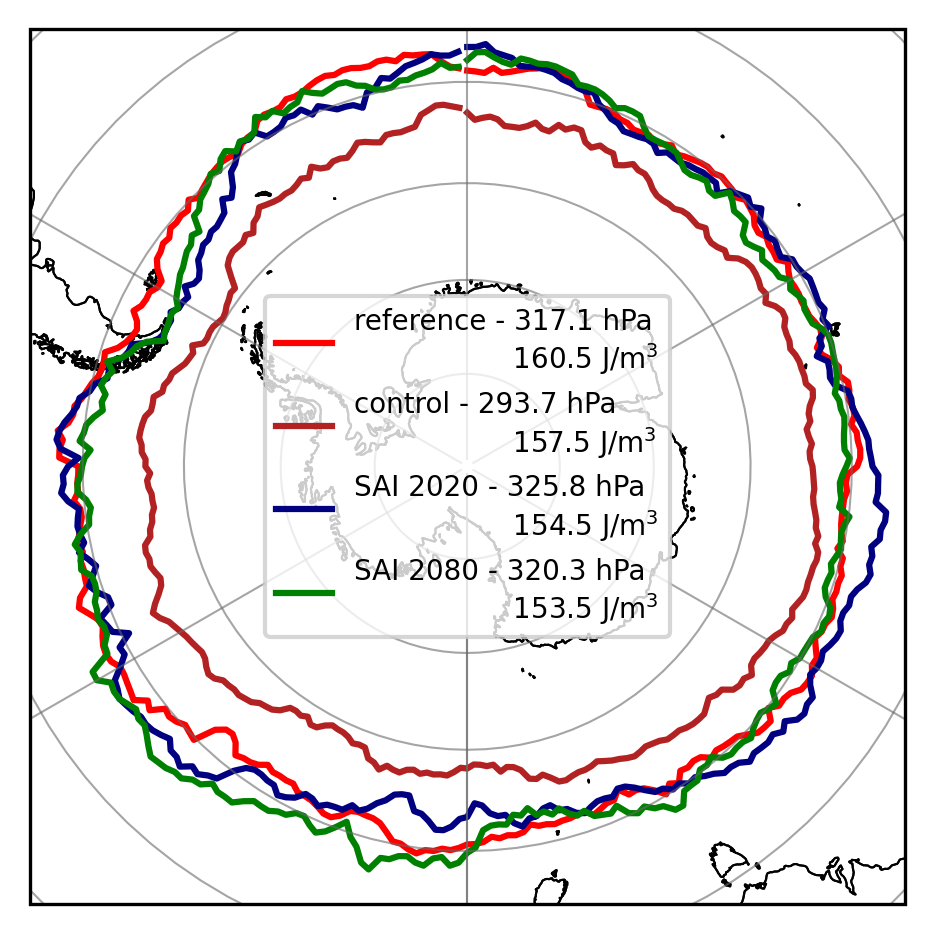

In [22]:
scen = ['iJJA_c', 'fJJA_c', 'fJJA_20', 'fJJA_80']
labels = ['reference', 'control', 'SAI 2020', 'SAI 2080']
cols = ['red', 'firebrick', 'navy', 'green']

fig = plt.figure(figsize=(4,3), layout='constrained')

ax1 = fig.add_subplot(1,1,1,projection=ccrs.SouthPolarStereo(central_longitude=0, globe=None))
ax1.coastlines(resolution='50m', linewidth=0.5)

ax1.set_extent([-180, 180, -90, -45], ccrs.PlateCarree())
ax1.coastlines(resolution='50m', linewidth=0.5)

for i in range(len(scen)):
    EDJmax[scen[i]]['maxlats'].plot(ax=ax1, transform=ccrs.PlateCarree(), color=cols[i], label=labels[i] + ' - ' 
                                    + str(np.round(EDJmax[scen[i]]['maxplevs'].mean(dim='lon').values, decimals=1))+' hPa\n\t\t  '.expandtabs()
                                    + str(np.round(EDJmax[scen[i]]['maxval'].mean(dim='lon').values, decimals=1))+r' J/m$^3$')
gl = ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=False, linewidth=0.5, color='dimgray', alpha=0.6, linestyle='-')

ax1.legend(fontsize='small')
ax1.set_title('')

if save == True: plt.savefig(savepath+'EDJ_maxloc_JJA.png');



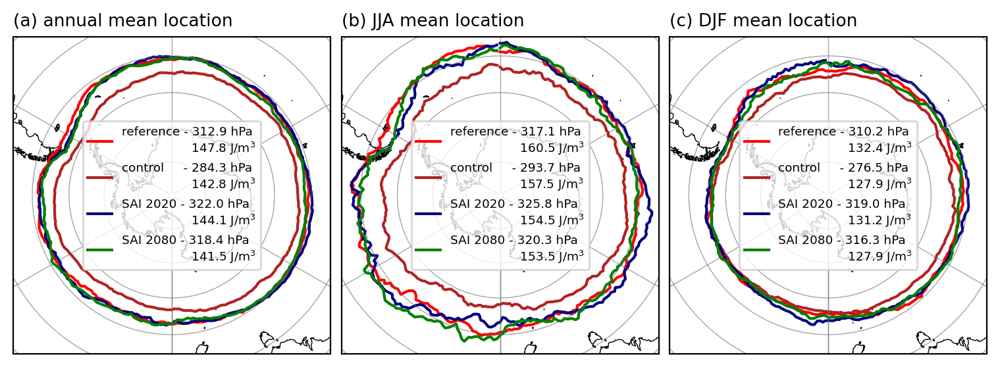

In [49]:
scen = ['i_c', 'f_c', 'f_20', 'f_80']
scenJJA = ['iJJA_c', 'fJJA_c', 'fJJA_20', 'fJJA_80']
scenDJF = ['iDJF_c', 'fDJF_c', 'fDJF_20', 'fDJF_80']
scen_stack = [scen, scenJJA, scenDJF]

labels = ['reference', 'control    ', 'SAI 2020', 'SAI 2080']
titles = ['(a) annual mean location', '(b) JJA mean location', '(c) DJF mean location']
cols = ['red', 'firebrick', 'navy', 'green']

fig, axs = plt.subplots(1, 3, figsize=imgsize3, layout='constrained', dpi=imgres, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=0, globe=None)})

for ax,j,n in zip(axs,scen_stack,range(len(axs))):
    ax.set_extent([-180, 180, -90, -45], ccrs.PlateCarree())
    ax.coastlines(resolution='50m', linewidth=0.5)

    for i in range(len(j)):
        EDJmax[j[i]]['maxlats'].plot(ax=ax, transform=ccrs.PlateCarree(), color=cols[i], label=labels[i] + ' - ' 
                                        + str(np.round(EDJmax[j[i]]['maxplevs'].mean(dim='lon').values, decimals=1))+' hPa\n\t\t  '.expandtabs()
                                        + str(np.round(EDJmax[j[i]]['maxval'].mean(dim='lon').values, decimals=1))+r' J/m$^3$')
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=False, linewidth=0.5, color='dimgray', alpha=0.6, linestyle='-')

    ax.legend(fontsize='small')

    ax.set_title(titles[n], loc='left')

if save == True: plt.savefig(savepath+'EDJ_maxloc.png');
    

## Subtropical jet

In [23]:
latmin = -85
latmax = -15
plevmin = 100
plevmax = 400
thresh = 40

STJ = {}
for i in scens:
    STJ[i] = jet_loc(U[i], 'U', thresh, lats=slice(latmin,latmax), plevs=slice(plevmin,plevmax))['count']

for i in scensJJA:
    STJ[i] = jet_loc(U[i], 'U', thresh, lats=slice(latmin,latmax), plevs=slice(plevmin,plevmax))['count']

for i in scensDJF:
    STJ[i] = jet_loc(U[i], 'U', thresh, lats=slice(latmin,latmax), plevs=slice(plevmin,plevmax))['count']


In [24]:
STJpm = {}
for i in scens:
    STJpm[i] = (STJ[i].sum(dim=['time','plev'])/(len(STJ[i].time)*len(STJ[i].plev))).compute()

for i in scensJJA:
    STJpm[i] = (STJ[i].sum(dim=['time','plev'])/(len(STJ[i].time)*len(STJ[i].plev))).compute()

for i in scensDJF:
    STJpm[i] = (STJ[i].sum(dim=['time','plev'])/(len(STJ[i].time)*len(STJ[i].plev))).compute()

In [26]:
STJmax = {}
for i in scens:
    STJmax[i] = jet_max(U[i], 'U', lats=slice(latmin,latmax), plevs=slice(plevmin,plevmax)).mean(dim='time')

for i in scensJJA:
    STJmax[i] = jet_max(U[i], 'U', lats=slice(latmin,latmax), plevs=slice(plevmin,plevmax)).mean(dim='time')

for i in scensDJF:
    STJmax[i] = jet_max(U[i], 'U', lats=slice(latmin,latmax), plevs=slice(plevmin,plevmax)).mean(dim='time')


## Intensity plots

In [ ]:
def STJplot():
    fig, axs = plt.subplots(2, 2, figsize=imgsize1, layout='constrained', dpi=imgres, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=0, globe=None)})

    for i,j,k in zip(axs.flatten(),scen_used,labels):
        i.coastlines(resolution='50m', linewidth=0.5)
        
        im = STJpm[j].plot(ax=i, transform=ccrs.PlateCarree(), cmap=plt.get_cmap('magma_r',30), vmin=0.05, vmax=0.8, add_colorbar=False)
        im.cmap.set_under('w')
    
        gl = i.gridlines(crs=ccrs.PlateCarree(), draw_labels=False, linewidth=0.5, color='dimgray', alpha=0.6, linestyle='-')
    
        i.set_title(k, loc='left')
    
    plt.colorbar(im, ax=axs, shrink=0.6, location='right', label=r'Intensity', extend='neither', ticks=[0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8])
    
    if save == True: plt.savefig(savepath+'STJ_map_'+timesel+'.png');


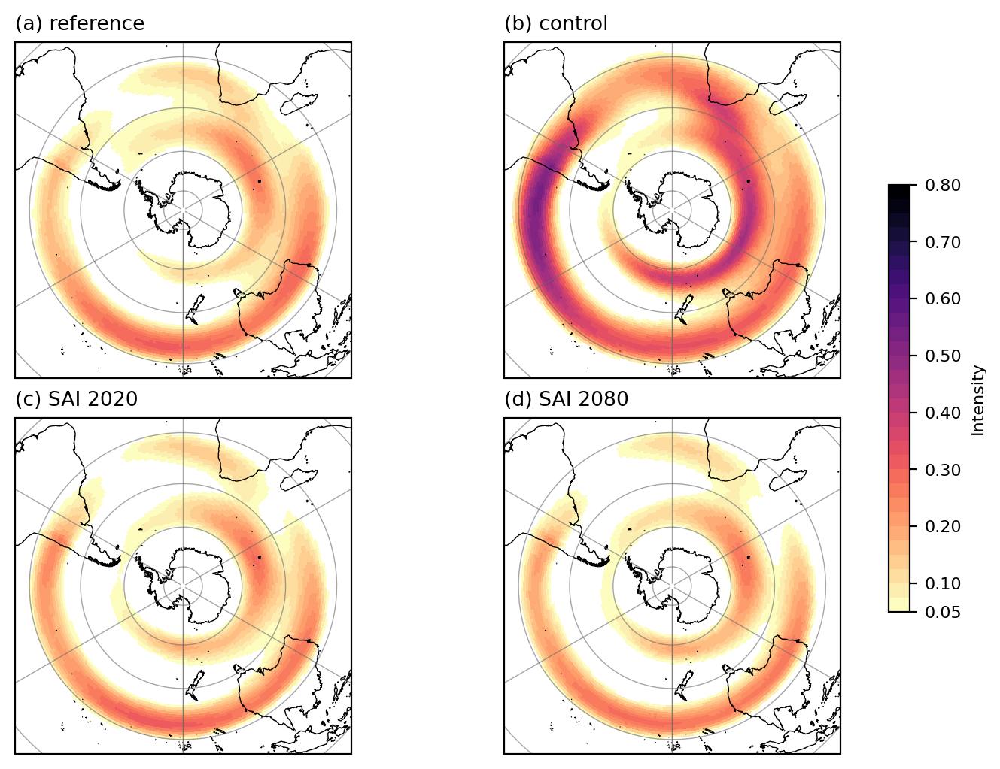

In [54]:
scen_used = ['i_c', 'f_c', 'f_20', 'f_80']
labels = ['(a) reference', '(b) control', '(c) SAI 2020', '(d) SAI 2080']
timesel = 'ann'

STJplot()

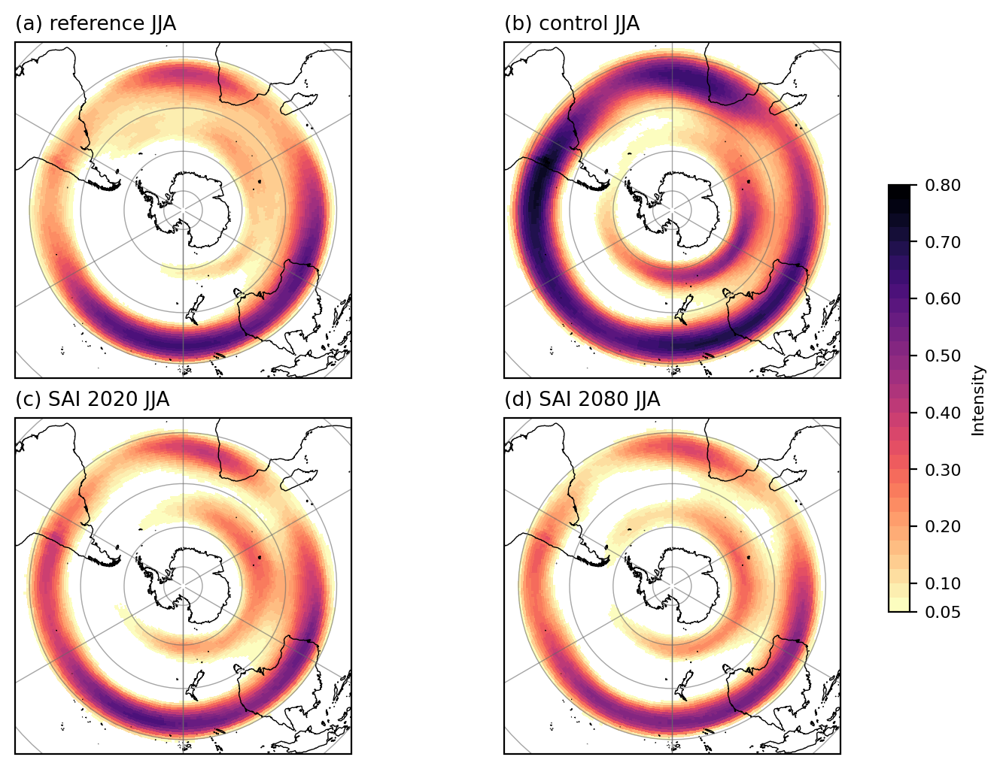

In [55]:
scen_used = ['iJJA_c', 'fJJA_c', 'fJJA_20', 'fJJA_80']
labels = ['(a) reference JJA', '(b) control JJA', '(c) SAI 2020 JJA', '(d) SAI 2080 JJA']
timesel = 'JJA'

STJplot()

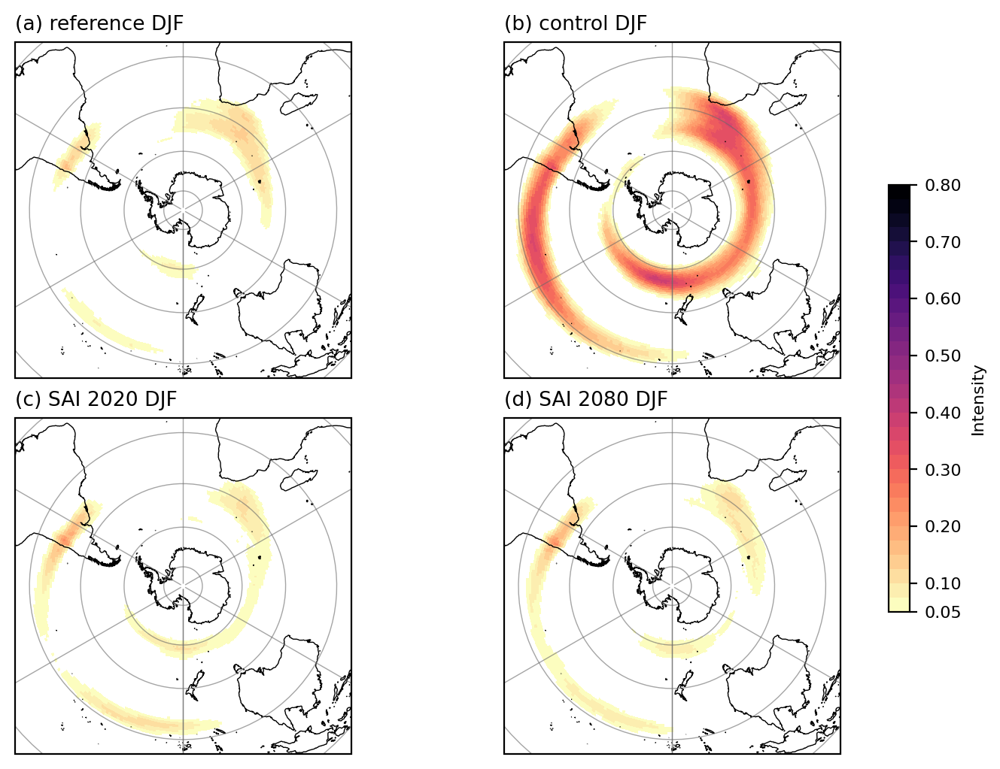

In [56]:
scen_used = ['iDJF_c', 'fDJF_c', 'fDJF_20', 'fDJF_80']
labels = ['(a) reference DJF', '(b) control DJF', '(c) SAI 2020 DJF', '(d) SAI 2080 DJF']
timesel = 'DJF'

STJplot()

## Location plots

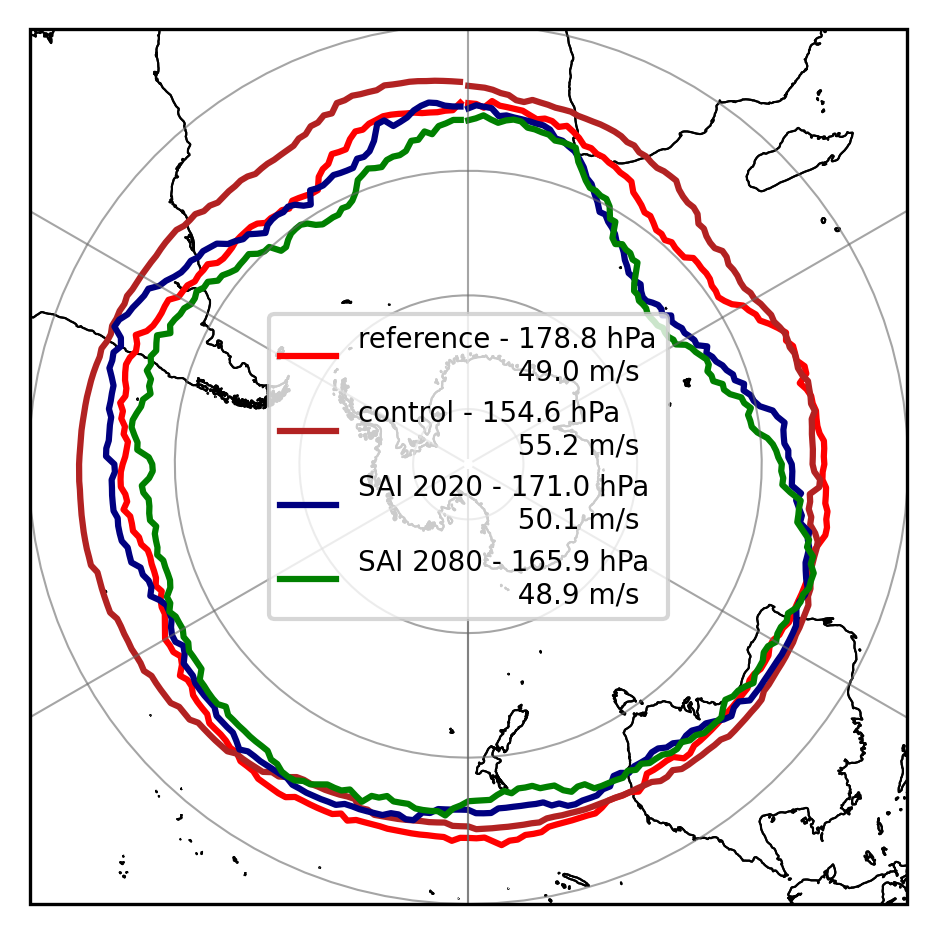

In [28]:
scen = ['iJJA_c', 'fJJA_c', 'fJJA_20', 'fJJA_80']
labels = ['reference', 'control', 'SAI 2020', 'SAI 2080']
cols = ['red', 'firebrick', 'navy', 'green']

fig = plt.figure(figsize=(4,3), layout='constrained')

ax1 = fig.add_subplot(1,1,1,projection=ccrs.SouthPolarStereo(central_longitude=0, globe=None))
ax1.coastlines(resolution='50m', linewidth=0.5)

ax1.set_extent([-180, 180, -90, -20], ccrs.PlateCarree())
ax1.coastlines(resolution='50m', linewidth=0.5)

for i in range(len(scen)):
    STJmax[scen[i]]['maxlats'].plot(ax=ax1, transform=ccrs.PlateCarree(), color=cols[i], label=labels[i] + ' - ' 
                                    + str(np.round(STJmax[scen[i]]['maxplevs'].mean(dim='lon').values, decimals=1))+' hPa\n\t\t  '.expandtabs()
                                    + str(np.round(STJmax[scen[i]]['maxval'].mean(dim='lon').values, decimals=1))+r' m/s')
gl = ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=False, linewidth=0.5, color='dimgray', alpha=0.6, linestyle='-')

ax1.legend(fontsize='small')
ax1.set_title('')

if save == True: plt.savefig(savepath+'STJ_maxloc_JJA.png');



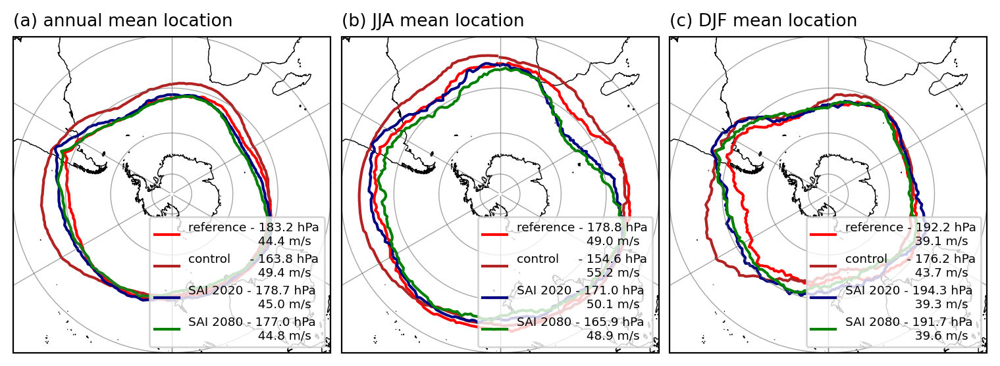

In [57]:
scen = ['i_c', 'f_c', 'f_20', 'f_80']
scenJJA = ['iJJA_c', 'fJJA_c', 'fJJA_20', 'fJJA_80']
scenDJF = ['iDJF_c', 'fDJF_c', 'fDJF_20', 'fDJF_80']
scen_stack = [scen, scenJJA, scenDJF]

labels = ['reference', 'control    ', 'SAI 2020', 'SAI 2080']
titles = ['(a) annual mean location', '(b) JJA mean location', '(c) DJF mean location']
cols = ['red', 'firebrick', 'navy', 'green']

fig, axs = plt.subplots(1, 3, figsize=imgsize3, layout='constrained', dpi=imgres, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=0, globe=None)})

for ax,j,n in zip(axs,scen_stack,range(len(axs))):
    ax.set_extent([-180, 180, -90, -20], ccrs.PlateCarree())
    ax.coastlines(resolution='50m', linewidth=0.5)

    for i in range(len(j)):
        STJmax[j[i]]['maxlats'].plot(ax=ax, transform=ccrs.PlateCarree(), color=cols[i], label=labels[i] + ' - ' 
                                        + str(np.round(STJmax[j[i]]['maxplevs'].mean(dim='lon').values, decimals=1))+' hPa\n\t\t  '.expandtabs()
                                        + str(np.round(STJmax[j[i]]['maxval'].mean(dim='lon').values, decimals=1))+r' m/s')
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=False, linewidth=0.5, color='dimgray', alpha=0.6, linestyle='-')

    if n == 3:
        ax.legend(fontsize='small', loc='upper right')
    else:
        ax.legend(fontsize='small', loc='lower right')

    ax.set_title(titles[n], loc='left')

if save == True: plt.savefig(savepath+'STJ_maxloc.png');
    